In [1]:
!pip install torch
!pip install torchvision

In [0]:
from __future__ import print_function
import torch
import torch.utils.data
from torch import nn, optim
from torch.nn import functional as F
from torch.nn import init
from torch.autograd import Variable
from torchvision import datasets, transforms
from torchvision.utils import save_image
from torch import distributions as D

from itertools import cycle
from functools import reduce
from operator import __or__
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.datasets import MNIST
import torchvision.transforms as transforms

In [0]:
import os
import time
import numpy as np
import glob
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import PIL
import imageio
import sys
import math
from sklearn.datasets import make_moons
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

from IPython import display

In [5]:
epochs=500
use_cuda = torch.cuda.is_available()
seed=1
torch.manual_seed(seed)

### Utils

In [0]:
def get_moons(batch_size=64, labels_per_class=10, n_labels=2):

    h = .02  # step size in the mesh

    datasets = make_moons(n_samples=1000, noise=0.1, random_state=0)

    X, y = datasets
    X = StandardScaler().fit_transform(X)
    X = X.astype(float)
    # Test size = 0.4
    X_train, X_test, y_train, y_test = \
        train_test_split(X, y, test_size=.4, random_state=42)


    # --------------- Plot:
    x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
    y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                          np.arange(y_min, y_max, h))

    # just plot the dataset first
    cm = plt.cm.RdBu
    cm_bright = ListedColormap(['#FF0000', '#0000FF'])
    # ax = plt.subplot(len(datasets), len(classifiers) + 1, i)
    # if ds_cnt == 0:
    fig, ax = plt.subplots()
    ax.set_title("Input data")
    # Plot the training points
    ax.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright,
                edgecolors='k')
    # Plot the testing points
    ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=cm_bright, alpha=0.2,
                edgecolors='k')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xticks(())
    ax.set_yticks(())

    plt.tight_layout()
    plt.show()
    # --------------------------------------------

    from torch.utils import data

    class HalfMoon(data.Dataset):
      'Characterizes a dataset for PyTorch'
      def __init__(self, points, labels):
            'Initialization'
            self.labels = labels
            self.points = points

      def __len__(self):
            'Denotes the total number of samples'
            return len(self.points)

      def __getitem__(self, index):
            'Generates one sample of data'
            # Select sample
            X = self.points[index]
            y = self.labels[index]

            return X, y

    moon_train = HalfMoon(X_train, y_train)
    moon_valid = HalfMoon(X_test, y_test)

    def get_sampler(labels, n=None):
        # Only choose digits in n_labels
        (indices,) = np.where(reduce(__or__, [labels == i for i in np.arange(n_labels)]))

        # Ensure uniform distribution of labels
        np.random.shuffle(indices)
        indices = np.hstack([list(filter(lambda idx: labels[idx] == i, indices))[:n] for i in range(n_labels)])

        indices = torch.from_numpy(indices)
        sampler = SubsetRandomSampler(indices)
        return sampler

    # Dataloaders for Half Moons
    labelled = torch.utils.data.DataLoader(moon_train, batch_size=batch_size, num_workers=2, pin_memory=use_cuda,
                                           sampler=get_sampler(y_train, labels_per_class))
    unlabelled = torch.utils.data.DataLoader(moon_train, batch_size=batch_size, num_workers=2, pin_memory=use_cuda,
                                             sampler=get_sampler(y_train))
    validation = torch.utils.data.DataLoader(moon_valid, batch_size=batch_size, num_workers=2, pin_memory=use_cuda,
                                             sampler=get_sampler(y_test))

    x_lab = np.array([])
    y_lab = np.array([])
    u_unlab = np.array([])
    v_unlab = np.array([])
    for (x, y) in labelled:
        x_lab = np.vstack([x_lab, x.numpy()]) if x_lab.size else x.numpy()
        y_lab = np.concatenate((y_lab, y.numpy()), axis=None) if y_lab.size else y.numpy()
    for (u, v) in unlabelled:
        u_unlab = np.vstack([u_unlab, u.numpy()]) if u_unlab.size else u.numpy()
        v_unlab = np.concatenate((v_unlab, v.numpy()), axis=None) if v_unlab.size else v.numpy()

    return labelled, unlabelled, validation, X_train, X_test, y_train, y_test, x_lab, y_lab, u_unlab, v_unlab

### Model

In [0]:
class M2(nn.Module):
  def __init__(self, x_dim=784, y_dim=10, z_dim=32, 
                     h_en_dim=[256, 128], h_de_dim=[128, 256], 
                     h_cls_dim=[256, 128]):
    super(M2, self).__init__()

    self.x_dim = x_dim
    self.y_dim = y_dim
    self.z_dim = z_dim

    en_neurons = [x_dim + y_dim, *h_en_dim]
    de_neurons = [y_dim + z_dim, *h_de_dim]
    cls_neurons = [x_dim, *h_cls_dim]

    en_linear_layers = [nn.Linear(en_neurons[i-1], en_neurons[i]) for i in range(1, len(en_neurons))]
    de_linear_layers = [nn.Linear(de_neurons[i-1], de_neurons[i]) for i in range(1, len(de_neurons))]
    cls_linear_layers = [nn.Linear(cls_neurons[i-1], cls_neurons[i]) for i in range(1, len(cls_neurons))]

    # For encoder - q(z|x,y)
    self.en_hidden = nn.ModuleList(en_linear_layers)
    self.mu = nn.Linear(h_en_dim[-1], z_dim)
    self.log_var = nn.Linear(h_en_dim[-1], z_dim)

    # For decoder - p(x|y,z)
    self.de_hidden = nn.ModuleList(de_linear_layers)
    self.reconstruction_mu = nn.Linear(h_de_dim[-1], x_dim)
    self.reconstruction_log_var = nn.Linear(h_de_dim[-1], x_dim)

    # For classifier - q(y|x)
    self.cls_hidden = nn.ModuleList(cls_linear_layers)
    self.logits = nn.Linear(h_cls_dim[-1], y_dim)

  def encode(self, x, y):
    h = torch.cat([x, y], dim=1)
    for layer in self.en_hidden:
        h = F.relu(layer(h))

    mu = self.mu(h)
    log_var = F.softplus(self.log_var(h))

    return self.reparameterize(mu, log_var), mu, log_var

  def reparameterize(self, mu, logvar):
    eps = Variable(torch.randn(mu.size()))
    if mu.is_cuda:
        eps = eps.cuda()

    std = torch.exp(0.5*logvar)
    return mu + eps*std

  def decode(self, y, z):
    h = torch.cat([y, z], dim=1)
    for layer in self.de_hidden:
        h = F.relu(layer(h))
    mu = self.reconstruction_mu(h)
    log_var = self.reconstruction_log_var(h)
    return mu, log_var

  def classify(self, x, apply_softmax=True):
    for layer in self.cls_hidden:
        x = F.relu(layer(x))
    logits = self.logits(x)
    if not apply_softmax:
      return logits
    probs = F.softmax(logits, dim=-1)
    return probs

  def sample(self, y, z):
    y = y.float()
    x_mu, x_log_var = self.decode(y, z)
    return self.reparameterize(x_mu, x_log_var)

  # Calculating ELBO (Both labelled or unlabelled)
  def forward(self, x, y=None):
    labelled = False if y is None else True

    xs, ys = (x, y)
    # Duplicating samples and generate labels if not labelled
    if not labelled:
      batch_size = xs.size(0)
      ys = torch.from_numpy(np.arange(self.y_dim))
      ys = ys.view(-1,1).repeat(1, batch_size).view(-1)
      ys = F.one_hot(ys, self.y_dim)
      ys = Variable(ys.float())
      ys = ys.cuda() if xs.is_cuda else ys
      xs = xs.repeat(self.y_dim, 1)
    
    # Reconstruction
    zs, z_mu, z_log_var = self.encode(xs, ys)
    x_mu, x_log_var = self.decode(ys, zs)

    # p(x|y,z)
    px_yz = D.normal.Normal(x_mu, torch.exp(0.5*x_log_var))
    px_yz = D.independent.Independent(px_yz, 1)
    loglikelihood = px_yz.log_prob(xs)

    # p(y)
    logprior_y = -math.log(self.y_dim)

    # KL(q(z|x,y)||p(z))
    p_z = D.normal.Normal(torch.zeros_like(zs), torch.ones_like(zs))
    p_z = D.independent.Independent(p_z, 1)
    q_z = D.normal.Normal(z_mu, torch.exp(0.5*z_log_var))
    q_z = D.independent.Independent(q_z, 1)
    kl = D.kl.kl_divergence(q_z, p_z)

    # ELBO : -L(x,y)
    neg_L = loglikelihood + logprior_y - kl

    if labelled:
      return torch.mean(neg_L)

    prob_y = self.classify(x)

    neg_L = neg_L.view_as(prob_y.t()).t()

    # H(q(y|x)) and sum over all labels
    H = -torch.sum(torch.mul(prob_y, torch.log(prob_y + 1e-8)), dim=-1)
    neg_L = torch.sum(torch.mul(prob_y, neg_L), dim=-1)

    # ELBO : -U(x)
    neg_U = neg_L + H
    return torch.mean(neg_U)

In [0]:
x_dim=2 
y_dim=2 
# z_dim=32
# h_en_dim=[256, 128]
# h_de_dim=[128, 256]
# h_cls_dim=256
z_dim=4
h_en_dim=[8, 16, 8]
h_de_dim=[8, 16, 8]
h_cls_dim=[8, 16, 8, 4]

model = M2(x_dim, y_dim, z_dim, h_en_dim, h_de_dim, h_cls_dim)

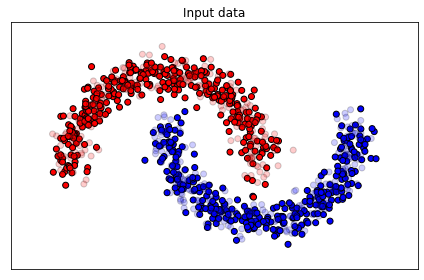

In [9]:
# Only use 10 labelled examples per class
# The rest of the data is unlabelled.
# labelled, unlabelled, validation = get_mnist(location="../data", batch_size=64, labels_per_class=10)
labelled, unlabelled, validation, X_train, X_test, y_train, y_test, x_lab, y_lab, u_unlab, v_unlab = get_moons(batch_size=64, labels_per_class=20)
alpha = 0.1 * len(unlabelled) / len(labelled)

optimizer = torch.optim.Adam(model.parameters(), lr=3e-4, betas=(0.9, 0.999))
if use_cuda: model = model.cuda()

In [0]:
def train(epoch):
  model.train()
  total_loss, accuracy = (0, 0)
  for (x, y), (u, _) in zip(cycle(labelled), unlabelled):
    y = F.one_hot(y, num_classes=y_dim)
    optimizer.zero_grad()
    # Wrap in variables
    x, y, u = Variable(x.float()), Variable(y.float()), Variable(u.float())

    if use_cuda:
      x, y = x.cuda(), y.cuda()
      u = u.cuda()

    L = -model(x, y)
    U = -model(u)

    # Add auxiliary classification loss q(y|x)
    prob_y = model.classify(x)
    
    # cross entropy
    classication_loss = -torch.sum(y * torch.log(prob_y + 1e-8), dim=1).mean()

    J_alpha = L + U + alpha * classication_loss

    J_alpha.backward()
    optimizer.step()
    
    total_loss += J_alpha.item()
    accuracy += torch.mean((torch.max(prob_y, 1)[1].data == torch.max(y, 1)[1].data).float()).item()

  # display.clear_output(wait=False)
  m = len(unlabelled)
  print("Epoch: {}".format(epoch))
  print("[Train]\t\t J_a: {:.2f}, accuracy: {:.2f}".format(total_loss / m, accuracy / m))
  return total_loss / m, accuracy / m


def test(epoch):

  model.eval()

  total_loss, accuracy = (0, 0)
  
  for x, y in validation:
    y = F.one_hot(y, num_classes=y_dim)
    x, y = Variable(x.float()), Variable(y.float())

    if use_cuda:
      x, y = x.cuda(), y.cuda()

    L = -model(x, y)
    U = -model(x)

    prob_y = model.classify(x)
    classication_loss = -torch.sum(y * torch.log(prob_y + 1e-8), dim=1).mean()

    J_alpha = L + U + alpha * classication_loss

    total_loss += J_alpha.item()

    _, pred_idx = torch.max(prob_y, 1)
    _, lab_idx = torch.max(y, 1)
    accuracy += torch.mean((pred_idx == lab_idx).float()).item()

  m = len(validation)
  print("[Validation]\t J_a: {:.2f}, accuracy: {:.2f}".format(total_loss / m, accuracy / m))
  return total_loss / m, accuracy / m


def draw_samples(n=10):
  model.eval()
  z = Variable(torch.randn(n, z_dim))

  y_ = np.array([0]*(n//2) + [1] * (n - n//2))
  y = torch.from_numpy(y_)
  y = Variable(F.one_hot(y, num_classes=y_dim).float())

  if use_cuda:
      z, y = z.cuda(), y.cuda()

  x = model.sample(y, z)
  samples = x.data.view(-1, 2).cpu().numpy()

  return samples, y_

Epoch: 1
[Train]		 J_a: 8.74, accuracy: 0.50
[Validation]	 J_a: 8.47, accuracy: 0.52
Epoch: 2
[Train]		 J_a: 8.68, accuracy: 0.50
[Validation]	 J_a: 8.39, accuracy: 0.52
Epoch: 3
[Train]		 J_a: 8.63, accuracy: 0.50
[Validation]	 J_a: 8.33, accuracy: 0.54
Epoch: 4
[Train]		 J_a: 8.60, accuracy: 0.50
[Validation]	 J_a: 8.28, accuracy: 0.56
Epoch: 5
[Train]		 J_a: 8.53, accuracy: 0.50
[Validation]	 J_a: 8.33, accuracy: 0.52
Epoch: 6
[Train]		 J_a: 8.48, accuracy: 0.50
[Validation]	 J_a: 8.27, accuracy: 0.52
Epoch: 7
[Train]		 J_a: 8.46, accuracy: 0.50
[Validation]	 J_a: 8.18, accuracy: 0.52
Epoch: 8
[Train]		 J_a: 8.42, accuracy: 0.50
[Validation]	 J_a: 8.10, accuracy: 0.54
Epoch: 9
[Train]		 J_a: 8.37, accuracy: 0.50
[Validation]	 J_a: 8.10, accuracy: 0.52
Epoch: 10
[Train]		 J_a: 8.34, accuracy: 0.50
[Validation]	 J_a: 8.17, accuracy: 0.53


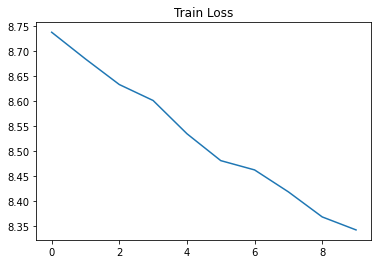

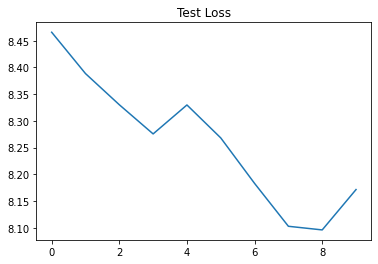

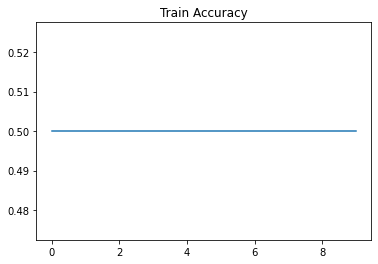

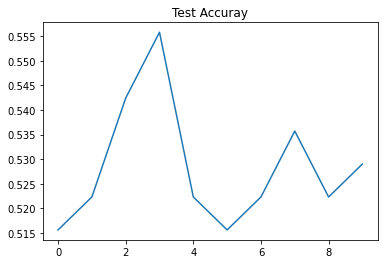

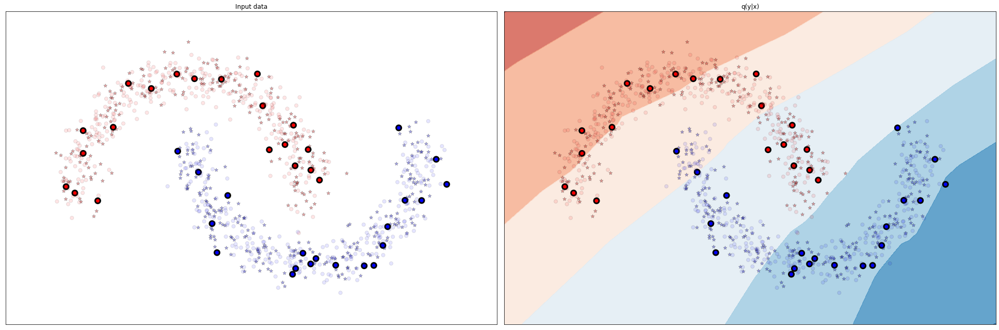

Epoch: 11
[Train]		 J_a: 8.30, accuracy: 0.50
[Validation]	 J_a: 8.07, accuracy: 0.51
Epoch: 12
[Train]		 J_a: 8.25, accuracy: 0.50
[Validation]	 J_a: 7.99, accuracy: 0.53
Epoch: 13
[Train]		 J_a: 8.22, accuracy: 0.50
[Validation]	 J_a: 7.91, accuracy: 0.56
Epoch: 14
[Train]		 J_a: 8.16, accuracy: 0.50
[Validation]	 J_a: 8.01, accuracy: 0.53
Epoch: 15
[Train]		 J_a: 8.14, accuracy: 0.50
[Validation]	 J_a: 7.89, accuracy: 0.54
Epoch: 16
[Train]		 J_a: 8.14, accuracy: 0.50
[Validation]	 J_a: 7.81, accuracy: 0.53
Epoch: 17
[Train]		 J_a: 8.06, accuracy: 0.50
[Validation]	 J_a: 7.82, accuracy: 0.52
Epoch: 18
[Train]		 J_a: 8.05, accuracy: 0.50
[Validation]	 J_a: 7.78, accuracy: 0.54
Epoch: 19
[Train]		 J_a: 8.02, accuracy: 0.50
[Validation]	 J_a: 7.79, accuracy: 0.54
Epoch: 20
[Train]		 J_a: 7.98, accuracy: 0.51
[Validation]	 J_a: 7.72, accuracy: 0.62


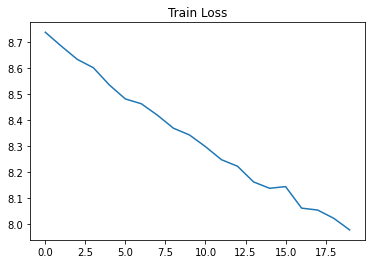

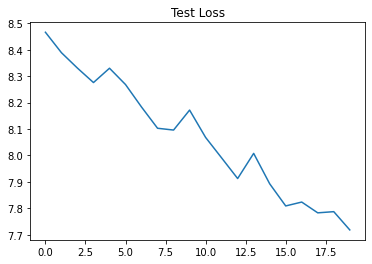

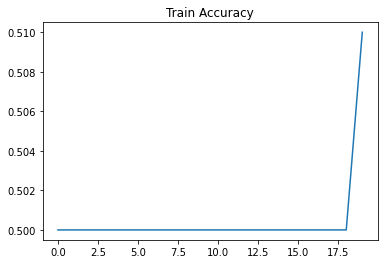

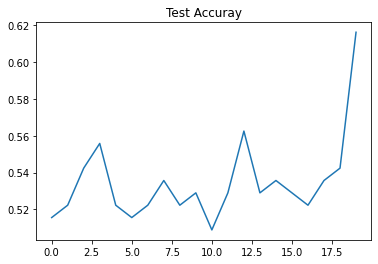

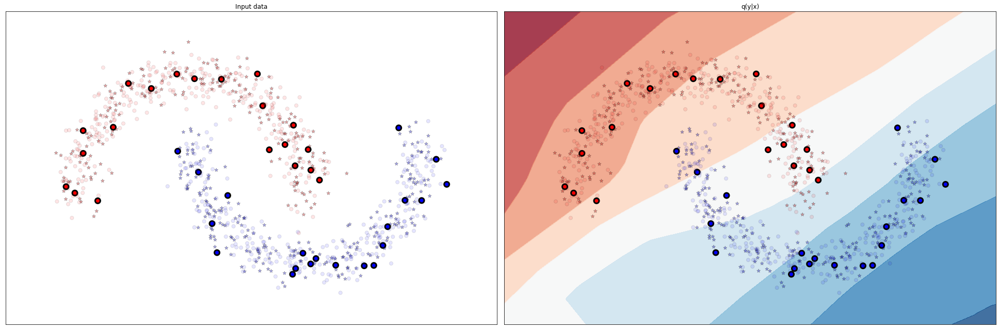

Epoch: 21
[Train]		 J_a: 7.93, accuracy: 0.65
[Validation]	 J_a: 7.67, accuracy: 0.73
Epoch: 22
[Train]		 J_a: 7.89, accuracy: 0.72
[Validation]	 J_a: 7.65, accuracy: 0.78
Epoch: 23
[Train]		 J_a: 7.86, accuracy: 0.76
[Validation]	 J_a: 7.65, accuracy: 0.79
Epoch: 24
[Train]		 J_a: 7.82, accuracy: 0.77
[Validation]	 J_a: 7.62, accuracy: 0.81
Epoch: 25
[Train]		 J_a: 7.79, accuracy: 0.77
[Validation]	 J_a: 7.54, accuracy: 0.78
Epoch: 26
[Train]		 J_a: 7.74, accuracy: 0.79
[Validation]	 J_a: 7.56, accuracy: 0.81
Epoch: 27
[Train]		 J_a: 7.71, accuracy: 0.77
[Validation]	 J_a: 7.55, accuracy: 0.81
Epoch: 28
[Train]		 J_a: 7.66, accuracy: 0.77
[Validation]	 J_a: 7.42, accuracy: 0.79
Epoch: 29
[Train]		 J_a: 7.64, accuracy: 0.77
[Validation]	 J_a: 7.38, accuracy: 0.79
Epoch: 30
[Train]		 J_a: 7.55, accuracy: 0.79
[Validation]	 J_a: 7.44, accuracy: 0.81


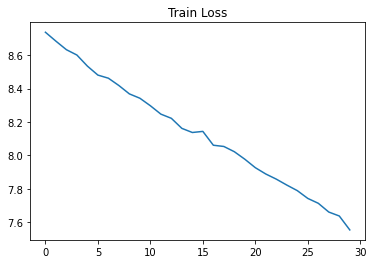

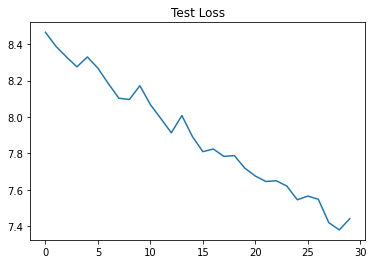

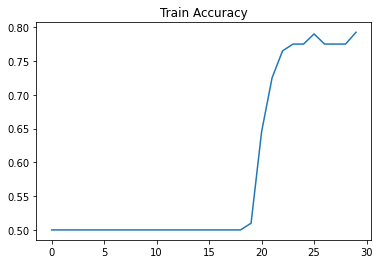

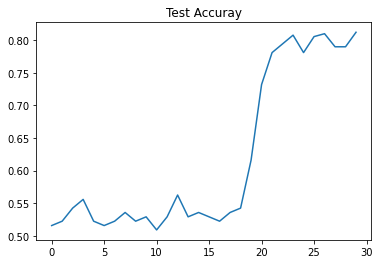

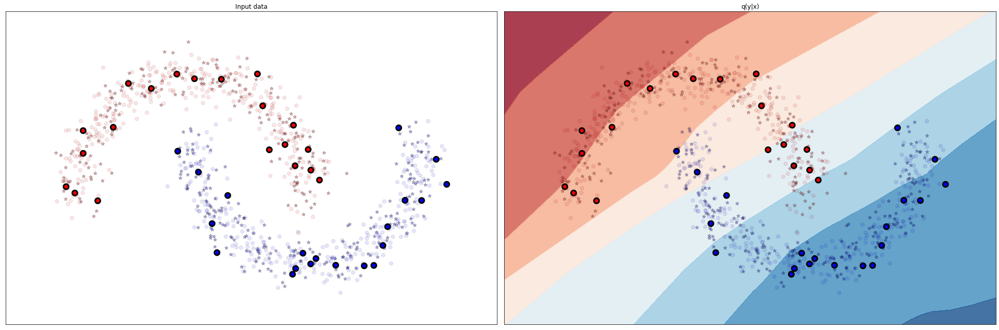

Epoch: 31
[Train]		 J_a: 7.53, accuracy: 0.82
[Validation]	 J_a: 7.39, accuracy: 0.83
Epoch: 32
[Train]		 J_a: 7.52, accuracy: 0.85
[Validation]	 J_a: 7.32, accuracy: 0.83
Epoch: 33
[Train]		 J_a: 7.49, accuracy: 0.85
[Validation]	 J_a: 7.30, accuracy: 0.84
Epoch: 34
[Train]		 J_a: 7.44, accuracy: 0.86
[Validation]	 J_a: 7.25, accuracy: 0.84
Epoch: 35
[Train]		 J_a: 7.42, accuracy: 0.88
[Validation]	 J_a: 7.29, accuracy: 0.84
Epoch: 36
[Train]		 J_a: 7.40, accuracy: 0.88
[Validation]	 J_a: 7.14, accuracy: 0.85
Epoch: 37
[Train]		 J_a: 7.34, accuracy: 0.88
[Validation]	 J_a: 7.19, accuracy: 0.86
Epoch: 38
[Train]		 J_a: 7.31, accuracy: 0.89
[Validation]	 J_a: 7.16, accuracy: 0.85
Epoch: 39
[Train]		 J_a: 7.26, accuracy: 0.90
[Validation]	 J_a: 7.15, accuracy: 0.87
Epoch: 40
[Train]		 J_a: 7.24, accuracy: 0.90
[Validation]	 J_a: 7.08, accuracy: 0.86


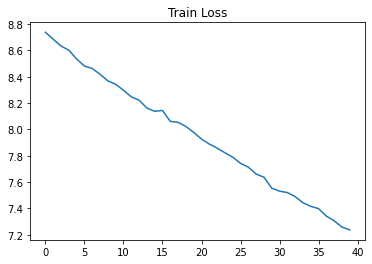

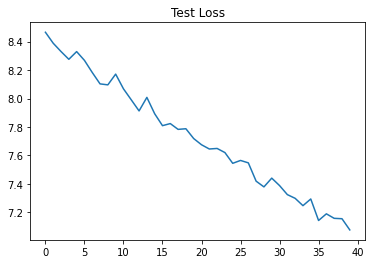

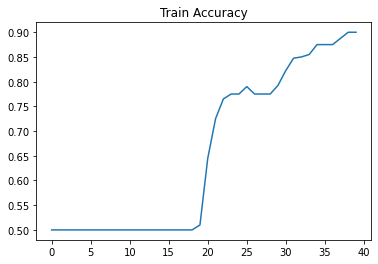

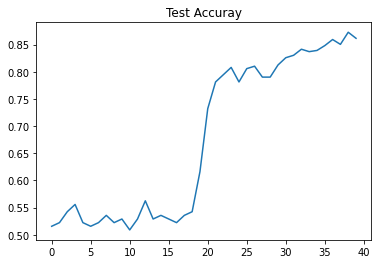

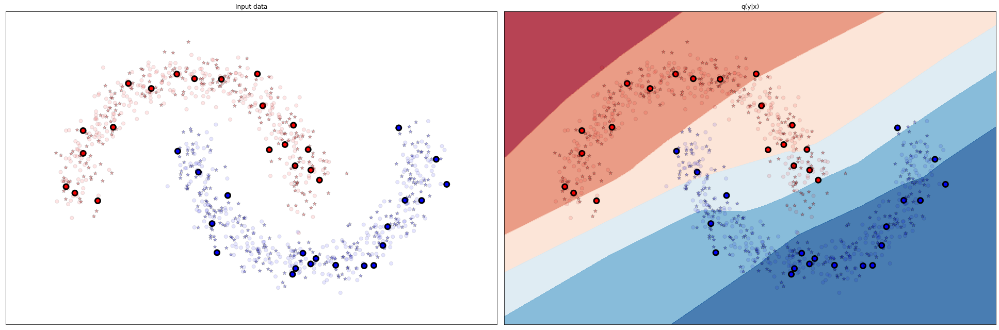

Epoch: 41
[Train]		 J_a: 7.19, accuracy: 0.90
[Validation]	 J_a: 7.03, accuracy: 0.87
Epoch: 42
[Train]		 J_a: 7.18, accuracy: 0.90
[Validation]	 J_a: 7.03, accuracy: 0.89
Epoch: 43
[Train]		 J_a: 7.16, accuracy: 0.90
[Validation]	 J_a: 7.00, accuracy: 0.89
Epoch: 44
[Train]		 J_a: 7.11, accuracy: 0.90
[Validation]	 J_a: 6.92, accuracy: 0.86
Epoch: 45
[Train]		 J_a: 7.07, accuracy: 0.90
[Validation]	 J_a: 6.92, accuracy: 0.88
Epoch: 46
[Train]		 J_a: 7.05, accuracy: 0.92
[Validation]	 J_a: 6.86, accuracy: 0.87
Epoch: 47
[Train]		 J_a: 7.01, accuracy: 0.93
[Validation]	 J_a: 6.81, accuracy: 0.88
Epoch: 48
[Train]		 J_a: 6.96, accuracy: 0.93
[Validation]	 J_a: 6.84, accuracy: 0.89
Epoch: 49
[Train]		 J_a: 6.91, accuracy: 0.93
[Validation]	 J_a: 6.76, accuracy: 0.88
Epoch: 50
[Train]		 J_a: 6.86, accuracy: 0.93
[Validation]	 J_a: 6.71, accuracy: 0.87


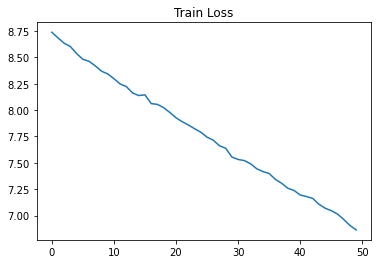

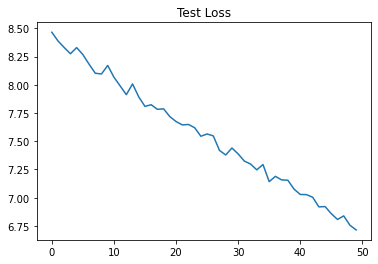

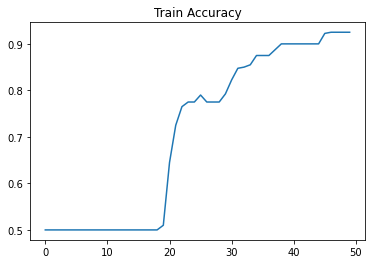

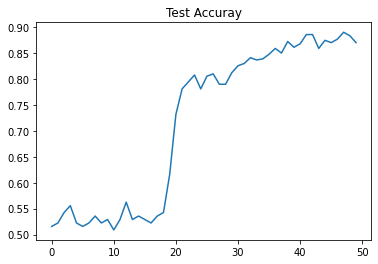

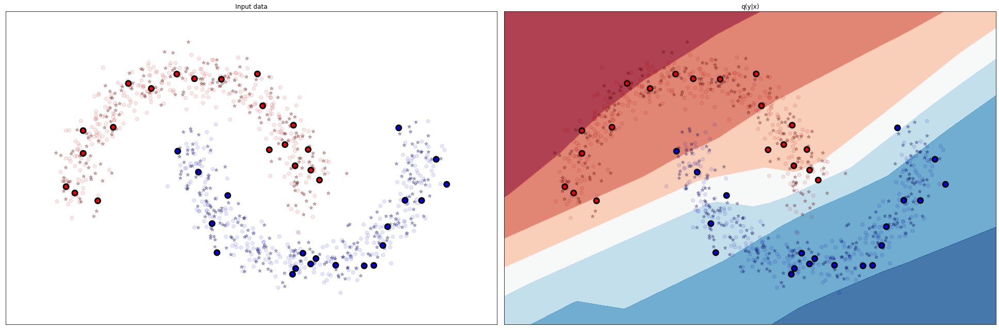

Epoch: 51
[Train]		 J_a: 6.86, accuracy: 0.93
[Validation]	 J_a: 6.73, accuracy: 0.88
Epoch: 52
[Train]		 J_a: 6.80, accuracy: 0.93
[Validation]	 J_a: 6.71, accuracy: 0.88
Epoch: 53
[Train]		 J_a: 6.77, accuracy: 0.93
[Validation]	 J_a: 6.62, accuracy: 0.88
Epoch: 54
[Train]		 J_a: 6.67, accuracy: 0.93
[Validation]	 J_a: 6.61, accuracy: 0.86
Epoch: 55
[Train]		 J_a: 6.67, accuracy: 0.93
[Validation]	 J_a: 6.55, accuracy: 0.88
Epoch: 56
[Train]		 J_a: 6.63, accuracy: 0.93
[Validation]	 J_a: 6.54, accuracy: 0.88
Epoch: 57
[Train]		 J_a: 6.59, accuracy: 0.93
[Validation]	 J_a: 6.46, accuracy: 0.88
Epoch: 58
[Train]		 J_a: 6.54, accuracy: 0.93
[Validation]	 J_a: 6.47, accuracy: 0.89
Epoch: 59
[Train]		 J_a: 6.51, accuracy: 0.93
[Validation]	 J_a: 6.44, accuracy: 0.87
Epoch: 60
[Train]		 J_a: 6.47, accuracy: 0.93
[Validation]	 J_a: 6.42, accuracy: 0.88


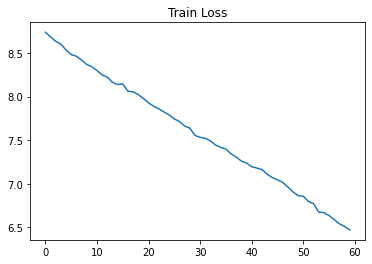

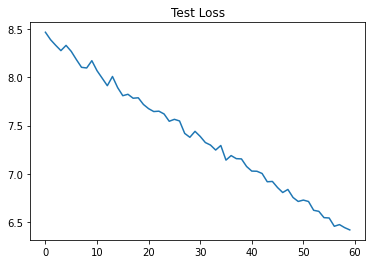

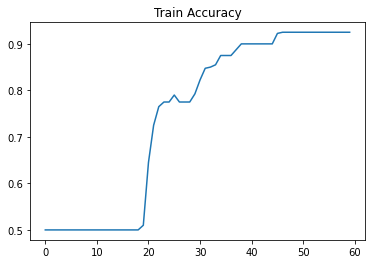

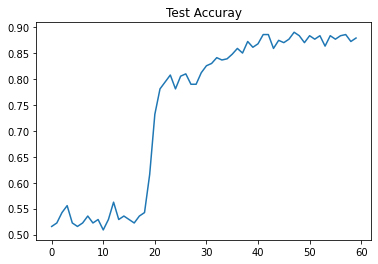

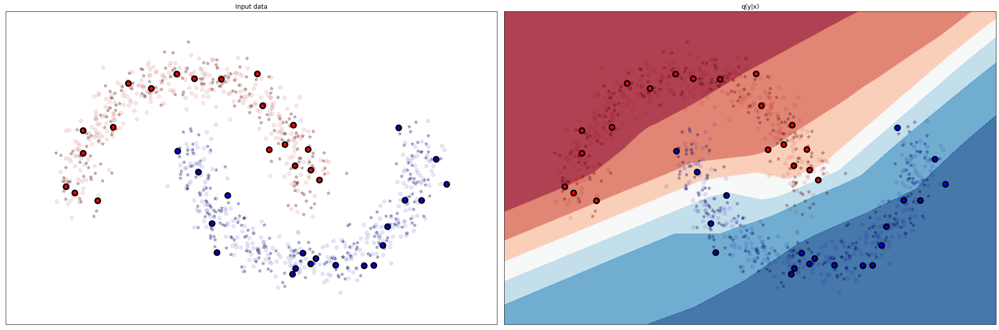

Epoch: 61
[Train]		 J_a: 6.43, accuracy: 0.93
[Validation]	 J_a: 6.36, accuracy: 0.89
Epoch: 62
[Train]		 J_a: 6.41, accuracy: 0.93
[Validation]	 J_a: 6.32, accuracy: 0.87
Epoch: 63
[Train]		 J_a: 6.37, accuracy: 0.93
[Validation]	 J_a: 6.34, accuracy: 0.87
Epoch: 64
[Train]		 J_a: 6.33, accuracy: 0.93
[Validation]	 J_a: 6.31, accuracy: 0.89
Epoch: 65
[Train]		 J_a: 6.30, accuracy: 0.93
[Validation]	 J_a: 6.28, accuracy: 0.88
Epoch: 66
[Train]		 J_a: 6.28, accuracy: 0.93
[Validation]	 J_a: 6.30, accuracy: 0.85
Epoch: 67
[Train]		 J_a: 6.23, accuracy: 0.93
[Validation]	 J_a: 6.23, accuracy: 0.88
Epoch: 68
[Train]		 J_a: 6.21, accuracy: 0.93
[Validation]	 J_a: 6.20, accuracy: 0.89
Epoch: 69
[Train]		 J_a: 6.18, accuracy: 0.93
[Validation]	 J_a: 6.21, accuracy: 0.88
Epoch: 70
[Train]		 J_a: 6.18, accuracy: 0.93
[Validation]	 J_a: 6.15, accuracy: 0.89


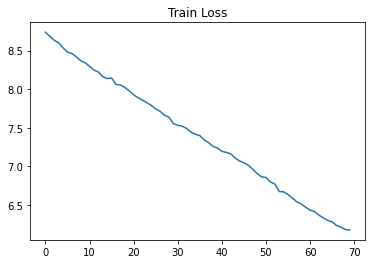

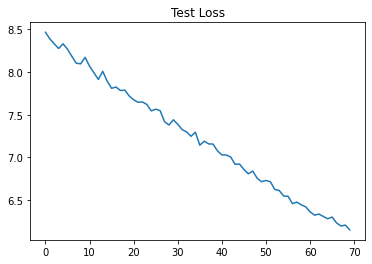

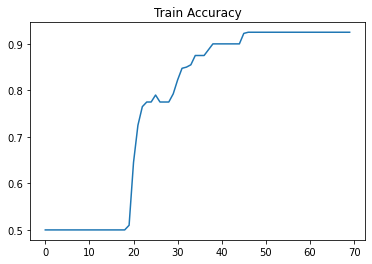

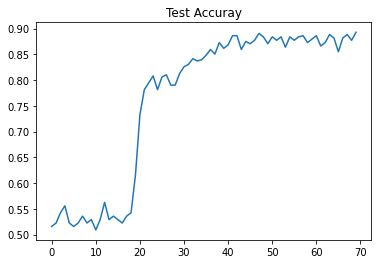

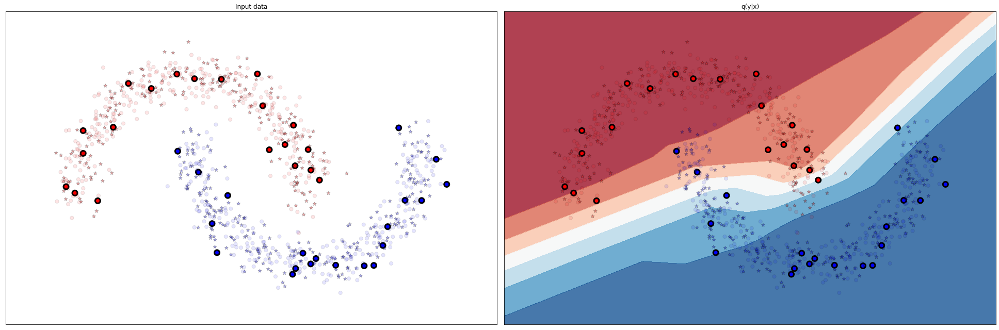

Epoch: 71
[Train]		 J_a: 6.16, accuracy: 0.93
[Validation]	 J_a: 6.15, accuracy: 0.89
Epoch: 72
[Train]		 J_a: 6.14, accuracy: 0.93
[Validation]	 J_a: 6.12, accuracy: 0.89
Epoch: 73
[Train]		 J_a: 6.10, accuracy: 0.93
[Validation]	 J_a: 6.13, accuracy: 0.89
Epoch: 74
[Train]		 J_a: 6.09, accuracy: 0.93
[Validation]	 J_a: 6.09, accuracy: 0.90
Epoch: 75
[Train]		 J_a: 6.07, accuracy: 0.93
[Validation]	 J_a: 6.12, accuracy: 0.90
Epoch: 76
[Train]		 J_a: 6.06, accuracy: 0.93
[Validation]	 J_a: 6.09, accuracy: 0.88
Epoch: 77
[Train]		 J_a: 6.05, accuracy: 0.93
[Validation]	 J_a: 6.05, accuracy: 0.91
Epoch: 78
[Train]		 J_a: 6.02, accuracy: 0.93
[Validation]	 J_a: 6.04, accuracy: 0.89
Epoch: 79
[Train]		 J_a: 6.01, accuracy: 0.93
[Validation]	 J_a: 6.05, accuracy: 0.91
Epoch: 80
[Train]		 J_a: 5.97, accuracy: 0.93
[Validation]	 J_a: 6.05, accuracy: 0.90


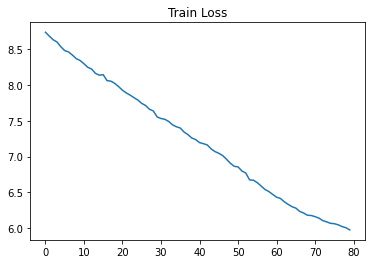

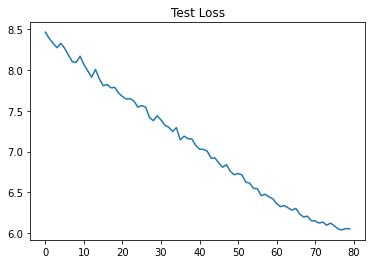

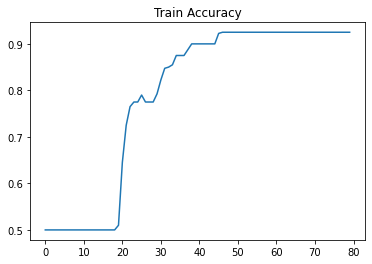

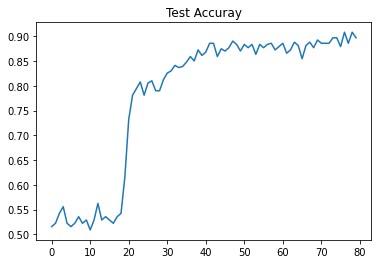

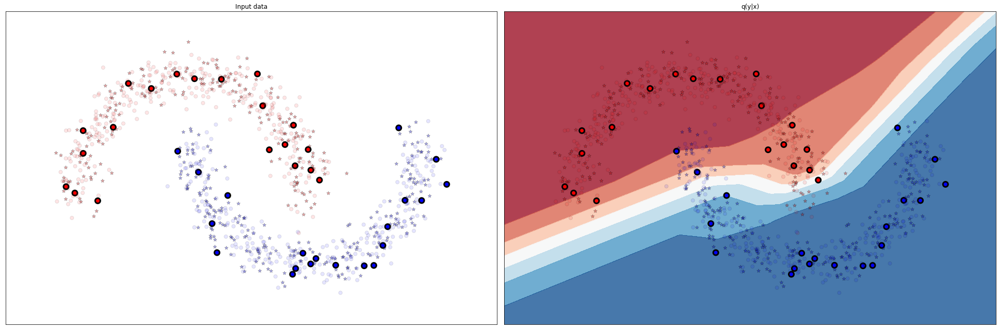

Epoch: 81
[Train]		 J_a: 5.96, accuracy: 0.93
[Validation]	 J_a: 6.01, accuracy: 0.90
Epoch: 82
[Train]		 J_a: 5.95, accuracy: 0.93
[Validation]	 J_a: 6.01, accuracy: 0.92
Epoch: 83
[Train]		 J_a: 5.94, accuracy: 0.93
[Validation]	 J_a: 6.00, accuracy: 0.89
Epoch: 84
[Train]		 J_a: 5.92, accuracy: 0.93
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 85
[Train]		 J_a: 5.90, accuracy: 0.93
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 86
[Train]		 J_a: 5.89, accuracy: 0.93
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 87
[Train]		 J_a: 5.87, accuracy: 0.94
[Validation]	 J_a: 5.96, accuracy: 0.91
Epoch: 88
[Train]		 J_a: 5.85, accuracy: 0.95
[Validation]	 J_a: 5.88, accuracy: 0.91
Epoch: 89
[Train]		 J_a: 5.85, accuracy: 0.95
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 90
[Train]		 J_a: 5.85, accuracy: 0.95
[Validation]	 J_a: 5.90, accuracy: 0.92


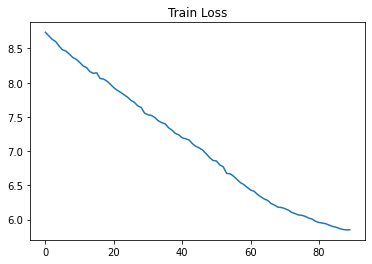

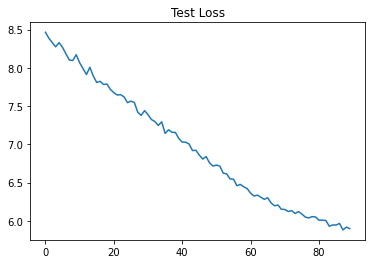

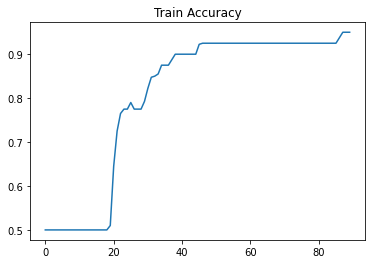

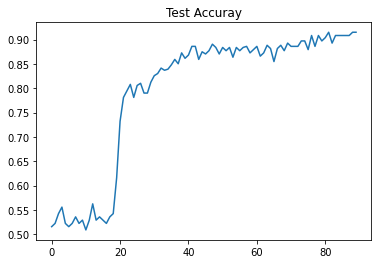

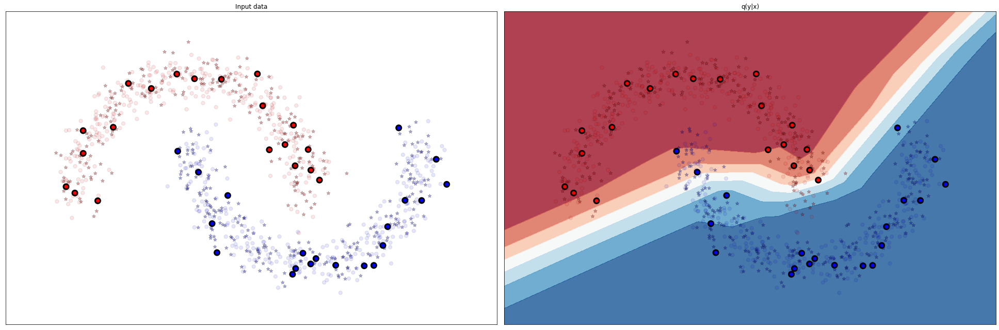

Epoch: 91
[Train]		 J_a: 5.84, accuracy: 0.95
[Validation]	 J_a: 5.87, accuracy: 0.91
Epoch: 92
[Train]		 J_a: 5.84, accuracy: 0.95
[Validation]	 J_a: 5.95, accuracy: 0.90
Epoch: 93
[Train]		 J_a: 5.82, accuracy: 0.95
[Validation]	 J_a: 5.91, accuracy: 0.90
Epoch: 94
[Train]		 J_a: 5.82, accuracy: 0.95
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 95
[Train]		 J_a: 5.81, accuracy: 0.95
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 96
[Train]		 J_a: 5.82, accuracy: 0.95
[Validation]	 J_a: 5.96, accuracy: 0.89
Epoch: 97
[Train]		 J_a: 5.80, accuracy: 0.95
[Validation]	 J_a: 5.89, accuracy: 0.90
Epoch: 98
[Train]		 J_a: 5.79, accuracy: 0.95
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 99
[Train]		 J_a: 5.80, accuracy: 0.95
[Validation]	 J_a: 5.90, accuracy: 0.90
Epoch: 100
[Train]		 J_a: 5.80, accuracy: 0.95
[Validation]	 J_a: 5.85, accuracy: 0.90


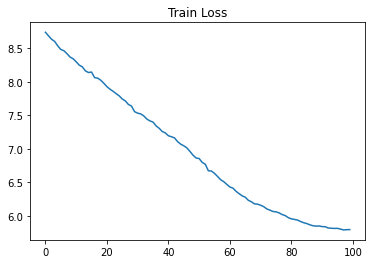

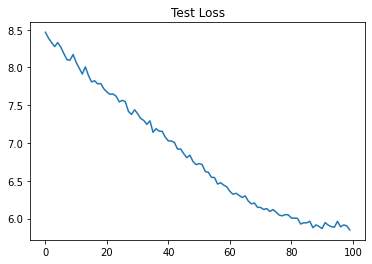

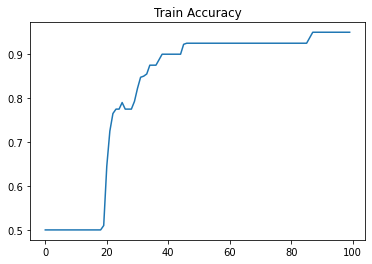

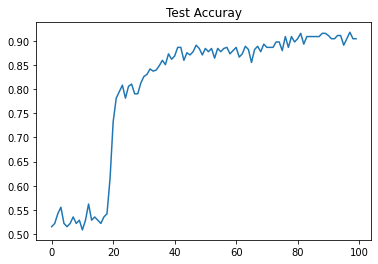

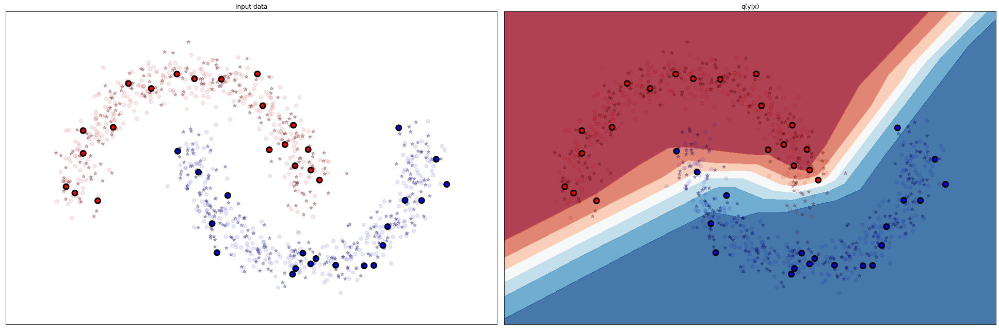

Epoch: 101
[Train]		 J_a: 5.80, accuracy: 0.95
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 102
[Train]		 J_a: 5.78, accuracy: 0.95
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 103
[Train]		 J_a: 5.78, accuracy: 0.95
[Validation]	 J_a: 5.83, accuracy: 0.92
Epoch: 104
[Train]		 J_a: 5.76, accuracy: 0.95
[Validation]	 J_a: 5.90, accuracy: 0.91
Epoch: 105
[Train]		 J_a: 5.78, accuracy: 0.95
[Validation]	 J_a: 5.82, accuracy: 0.91
Epoch: 106
[Train]		 J_a: 5.78, accuracy: 0.95
[Validation]	 J_a: 5.86, accuracy: 0.91
Epoch: 107
[Train]		 J_a: 5.77, accuracy: 0.95
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 108
[Train]		 J_a: 5.76, accuracy: 0.95
[Validation]	 J_a: 5.86, accuracy: 0.91
Epoch: 109
[Train]		 J_a: 5.78, accuracy: 0.95
[Validation]	 J_a: 5.88, accuracy: 0.91
Epoch: 110
[Train]		 J_a: 5.76, accuracy: 0.95
[Validation]	 J_a: 5.83, accuracy: 0.92


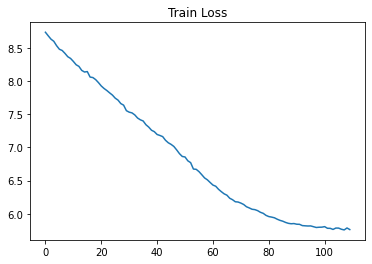

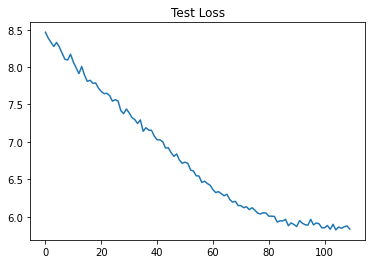

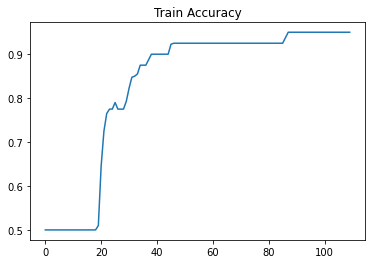

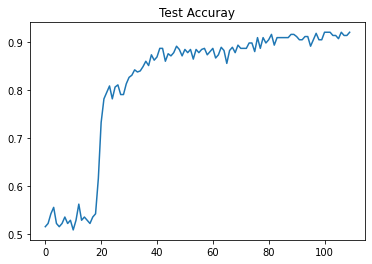

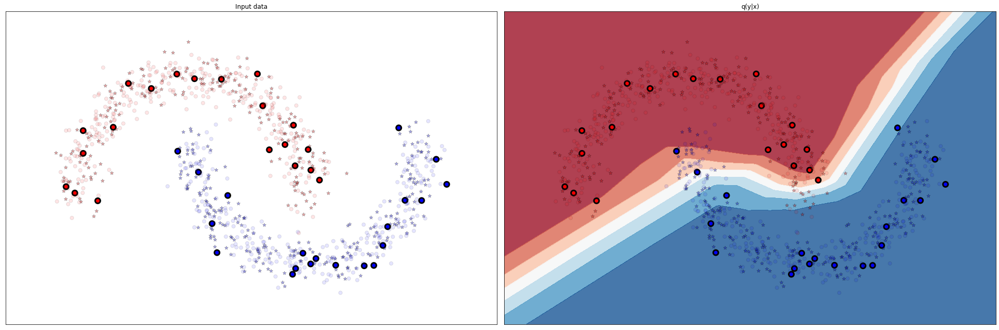

Epoch: 111
[Train]		 J_a: 5.77, accuracy: 0.95
[Validation]	 J_a: 5.82, accuracy: 0.92
Epoch: 112
[Train]		 J_a: 5.76, accuracy: 0.97
[Validation]	 J_a: 5.89, accuracy: 0.89
Epoch: 113
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.90
Epoch: 114
[Train]		 J_a: 5.76, accuracy: 0.96
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 115
[Train]		 J_a: 5.76, accuracy: 0.96
[Validation]	 J_a: 5.86, accuracy: 0.91
Epoch: 116
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.91
Epoch: 117
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.91
Epoch: 118
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 119
[Train]		 J_a: 5.78, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 120
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.80, accuracy: 0.92


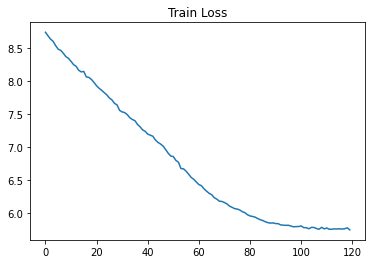

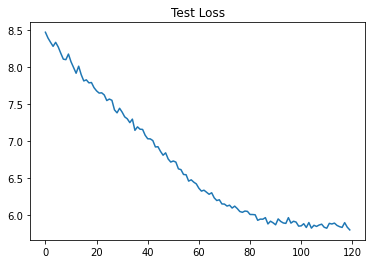

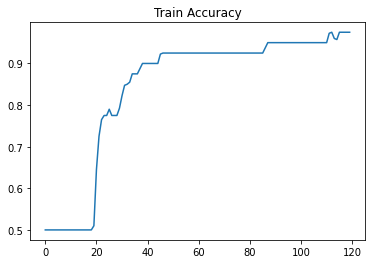

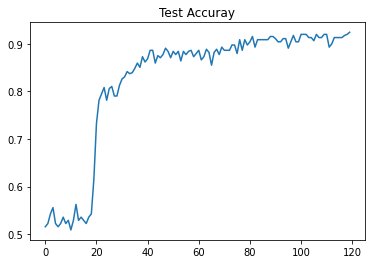

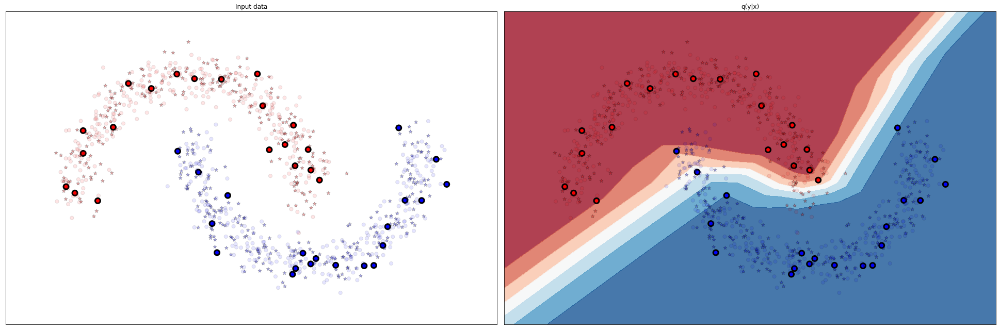

Epoch: 121
[Train]		 J_a: 5.77, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.92
Epoch: 122
[Train]		 J_a: 5.77, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.90
Epoch: 123
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.90
Epoch: 124
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.91
Epoch: 125
[Train]		 J_a: 5.78, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 126
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 127
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 128
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 129
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 130
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92


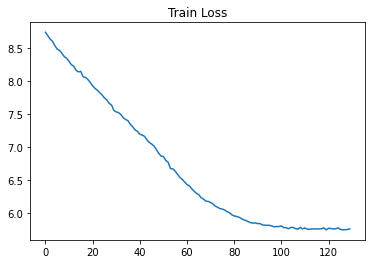

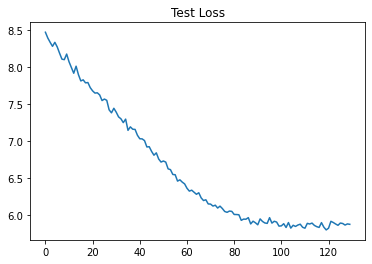

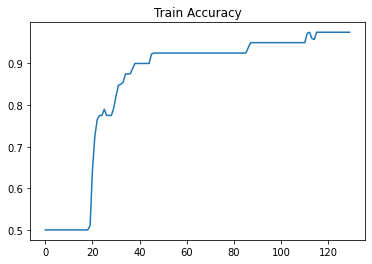

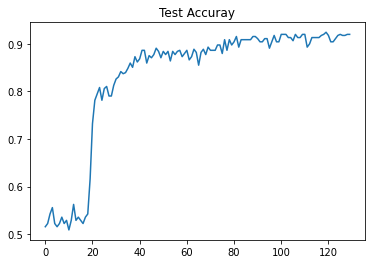

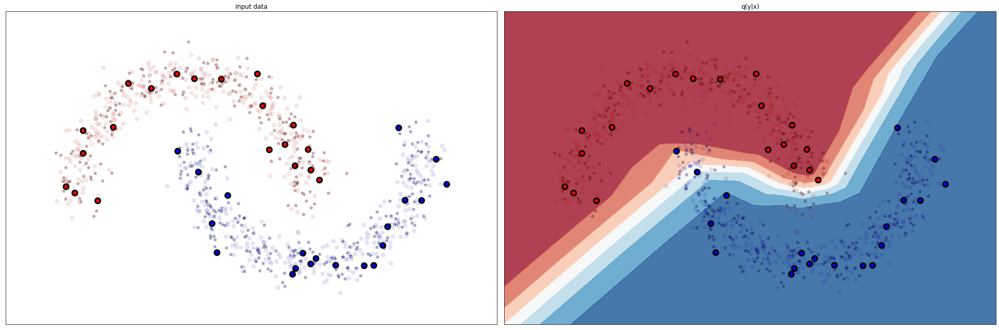

Epoch: 131
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 132
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 133
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.91
Epoch: 134
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 135
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 136
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 137
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 138
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.91
Epoch: 139
[Train]		 J_a: 5.76, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.91
Epoch: 140
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92


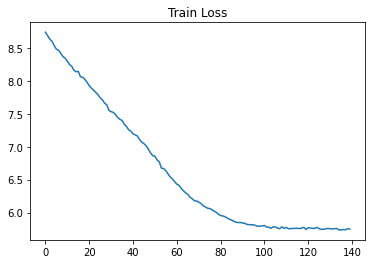

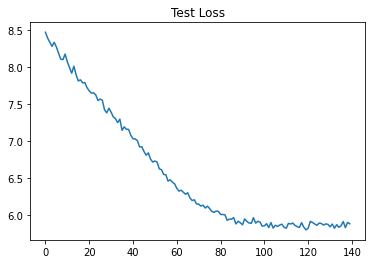

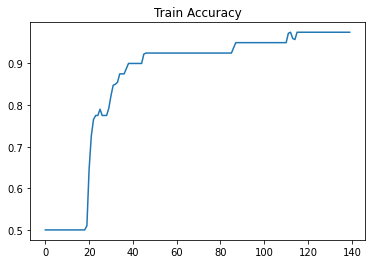

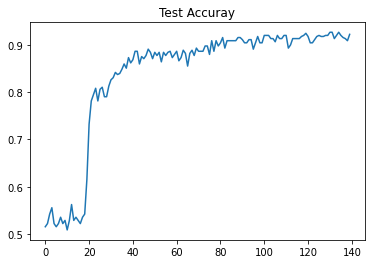

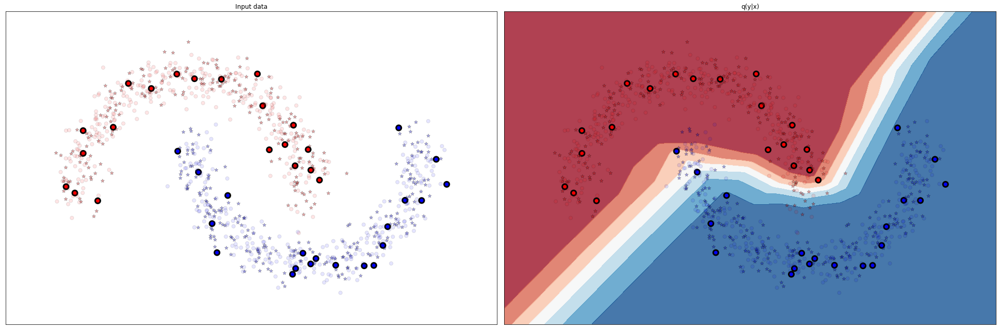

Epoch: 141
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 142
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.94
Epoch: 143
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.91
Epoch: 144
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 145
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 146
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 147
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 148
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.92
Epoch: 149
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.91
Epoch: 150
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93


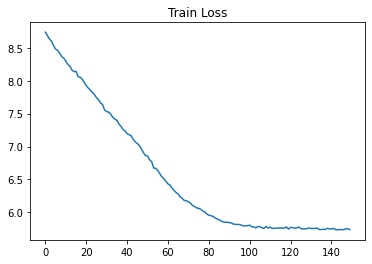

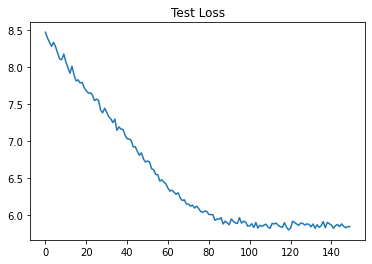

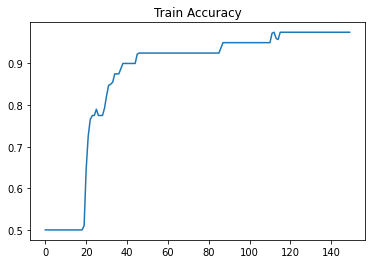

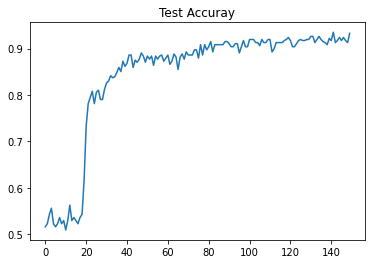

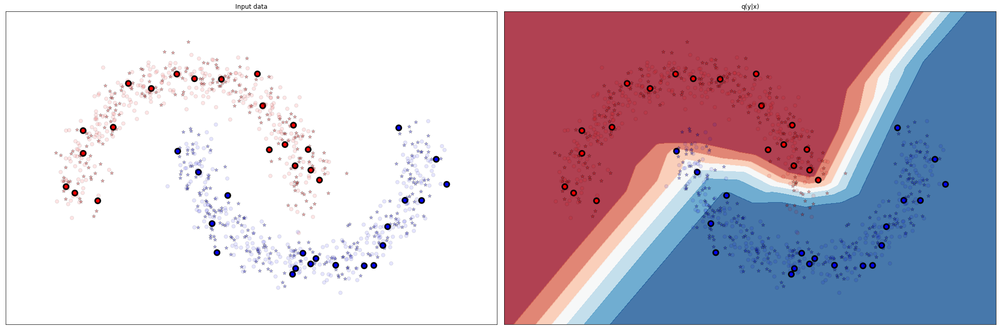

Epoch: 151
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 152
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 153
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 154
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 155
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 156
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 157
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.94
Epoch: 158
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.79, accuracy: 0.93
Epoch: 159
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 160
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.91


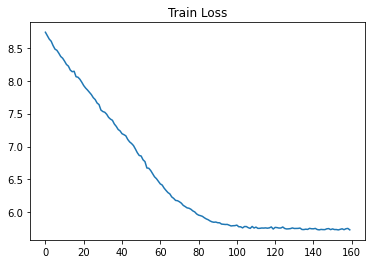

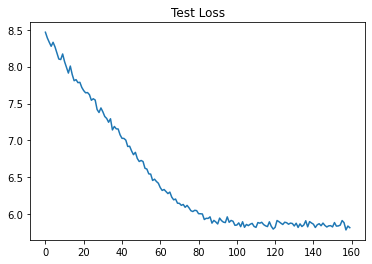

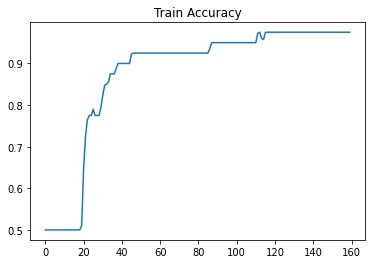

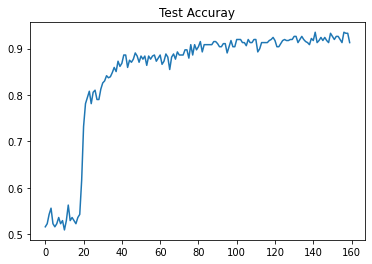

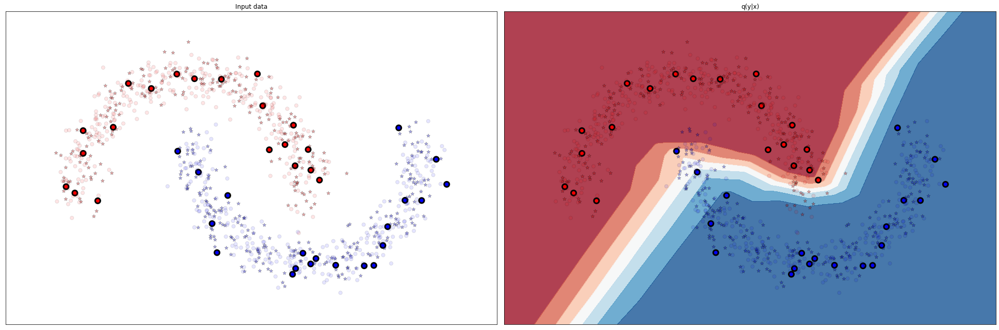

Epoch: 161
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 162
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.93
Epoch: 163
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 164
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 165
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 166
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 167
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 168
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.93
Epoch: 169
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.80, accuracy: 0.93
Epoch: 170
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.93


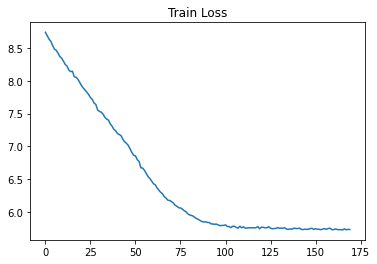

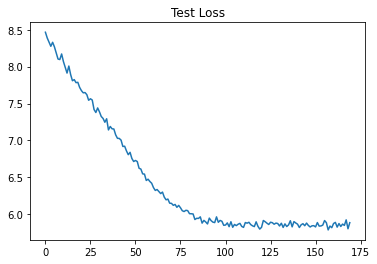

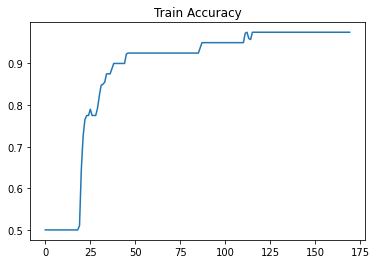

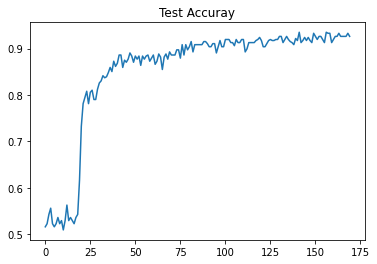

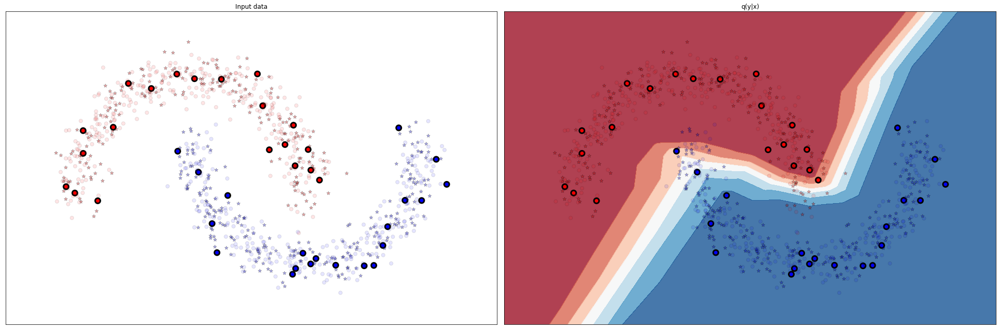

Epoch: 171
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.81, accuracy: 0.92
Epoch: 172
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 173
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 174
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 175
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 176
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.79, accuracy: 0.92
Epoch: 177
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.93
Epoch: 178
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 179
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 180
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.92


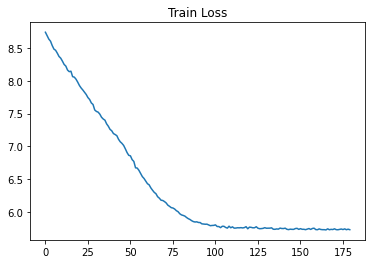

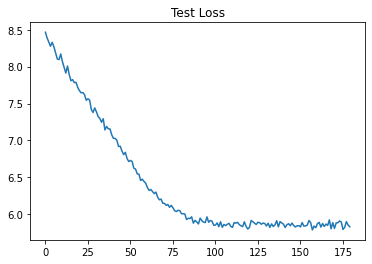

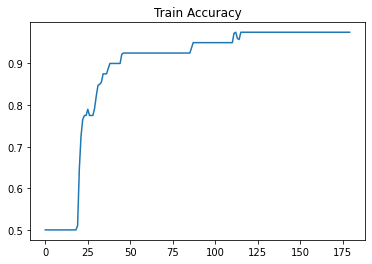

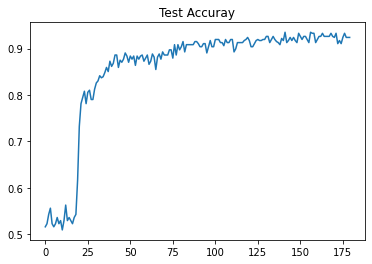

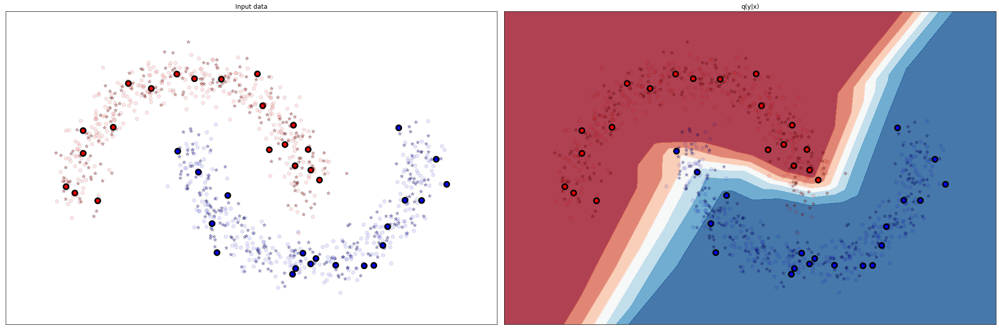

Epoch: 181
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 182
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 183
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.93
Epoch: 184
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 185
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 186
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 187
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.94, accuracy: 0.92
Epoch: 188
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 189
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 190
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92


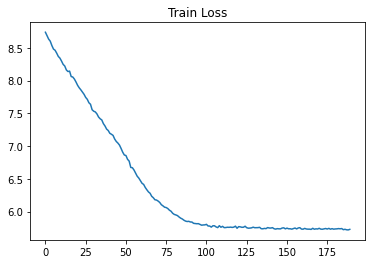

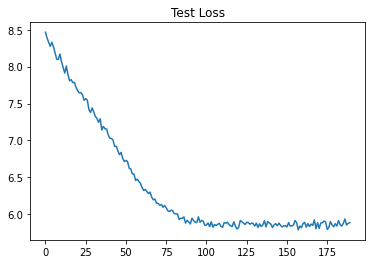

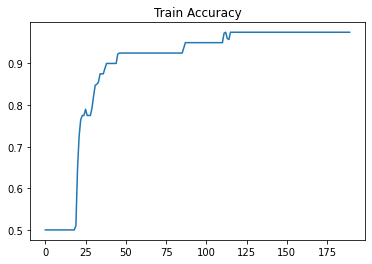

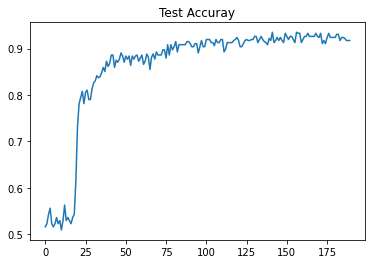

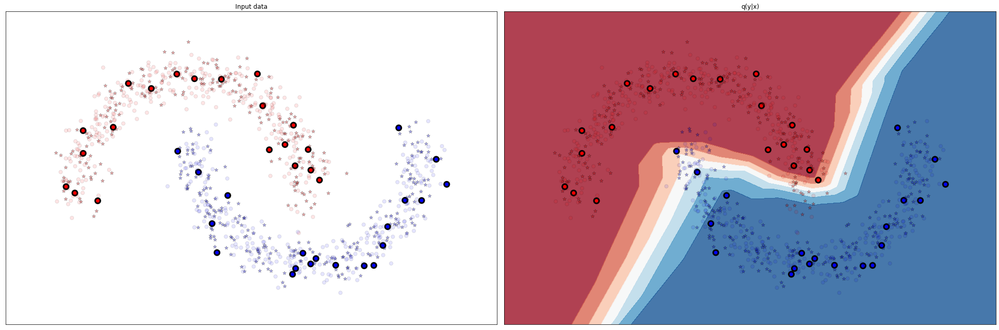

Epoch: 191
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 192
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 193
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 194
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.95, accuracy: 0.92
Epoch: 195
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 196
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 197
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 198
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 199
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 200
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92


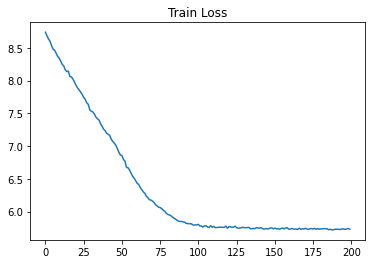

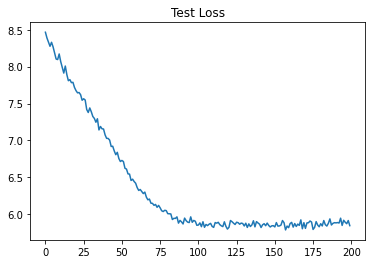

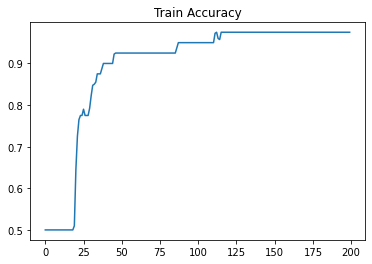

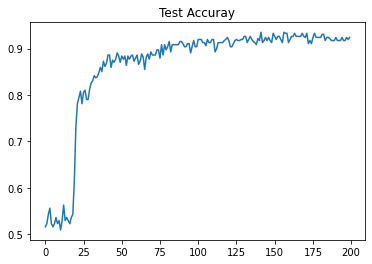

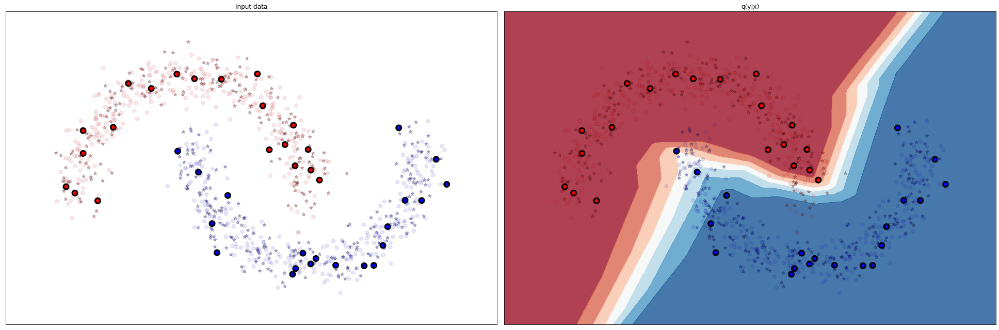

Epoch: 201
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 202
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 203
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 204
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 205
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 206
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 207
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 208
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 209
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 210
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93


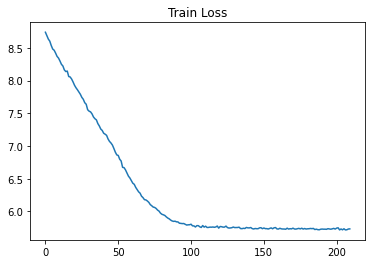

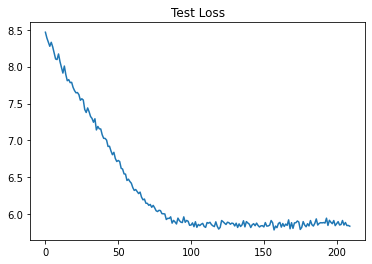

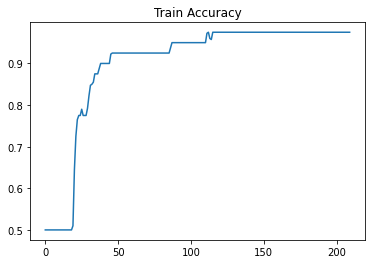

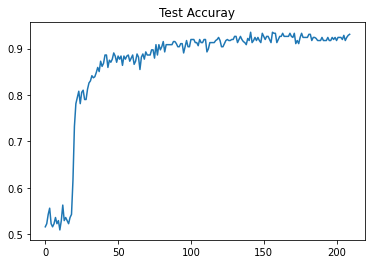

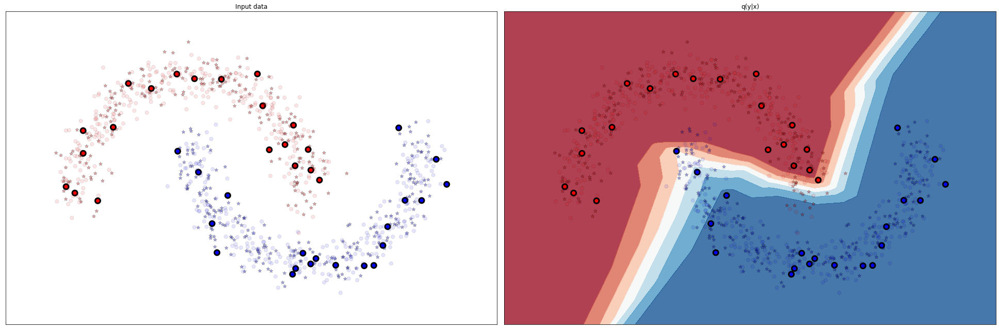

Epoch: 211
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.93
Epoch: 212
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 213
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.94
Epoch: 214
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.93
Epoch: 215
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.81, accuracy: 0.93
Epoch: 216
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 217
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.92
Epoch: 218
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.93, accuracy: 0.90
Epoch: 219
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.91
Epoch: 220
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.92


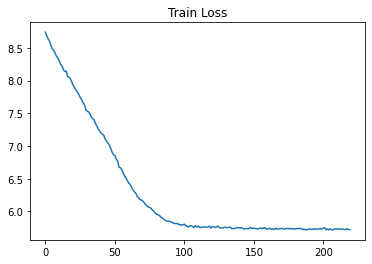

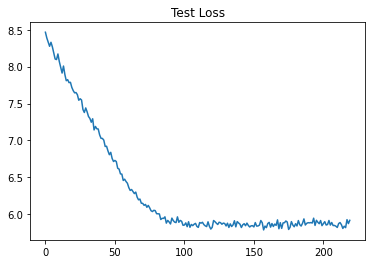

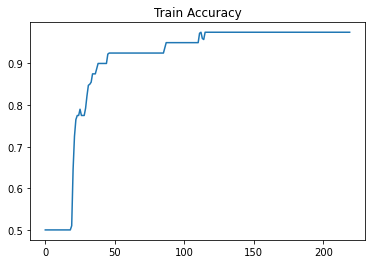

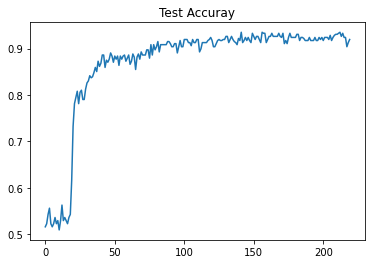

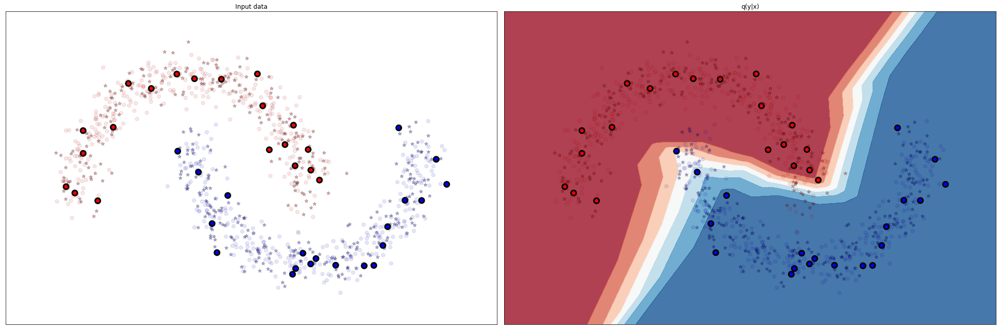

Epoch: 221
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.82, accuracy: 0.92
Epoch: 222
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.93
Epoch: 223
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 224
[Train]		 J_a: 5.75, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 225
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 226
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.94, accuracy: 0.92
Epoch: 227
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 6.00, accuracy: 0.91
Epoch: 228
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 229
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 230
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.93


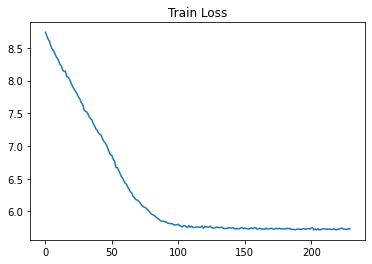

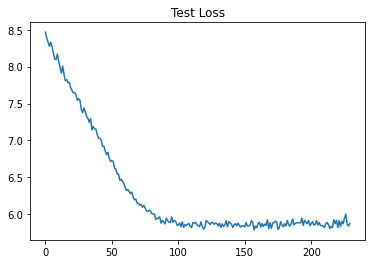

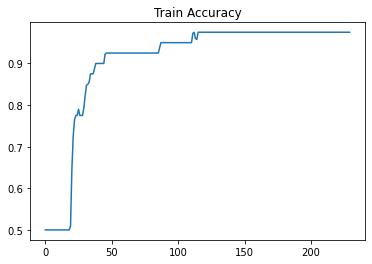

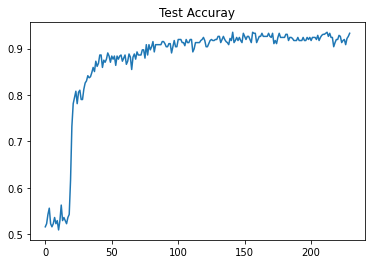

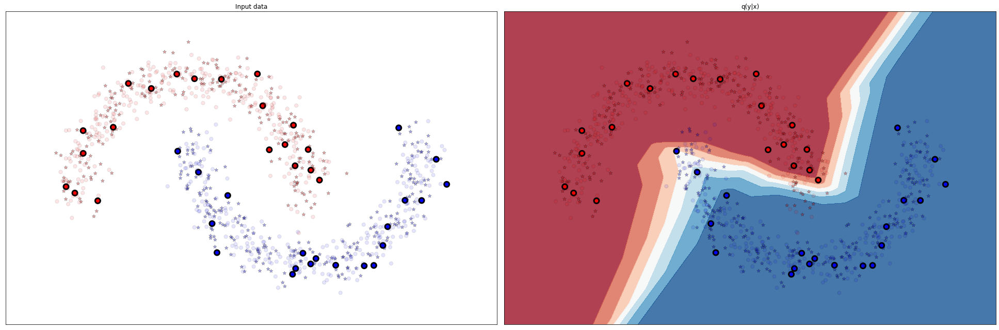

Epoch: 231
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 232
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 233
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 234
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 235
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 236
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 237
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 238
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 239
[Train]		 J_a: 5.73, accuracy: 0.99
[Validation]	 J_a: 5.90, accuracy: 0.93
Epoch: 240
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.95, accuracy: 0.90


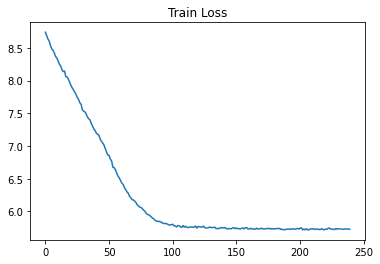

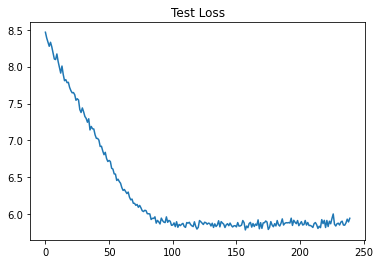

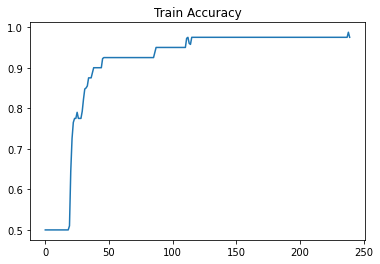

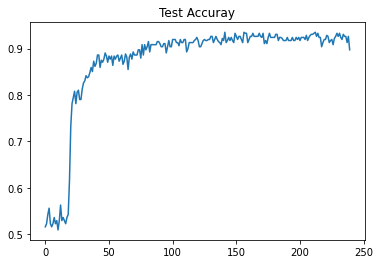

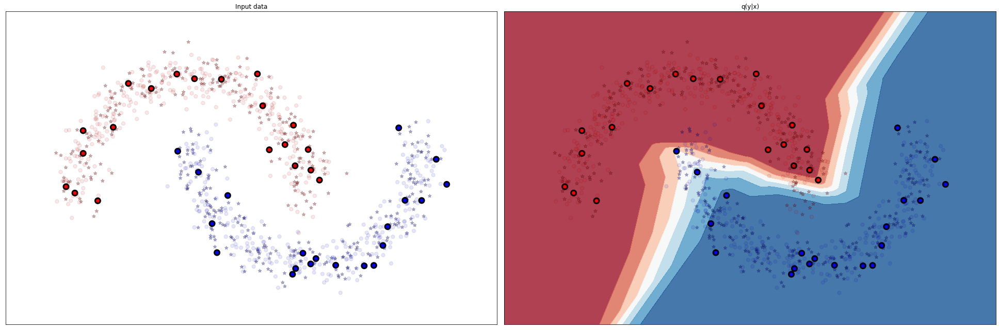

Epoch: 241
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 242
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 243
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 244
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 245
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 246
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 247
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 248
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.93
Epoch: 249
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 250
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.84, accuracy: 0.92


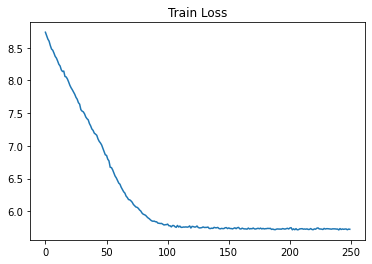

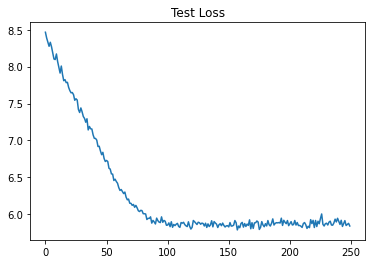

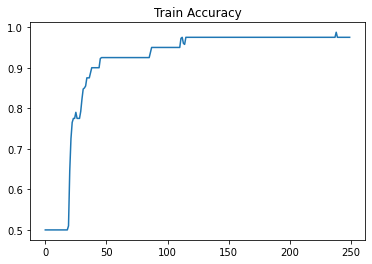

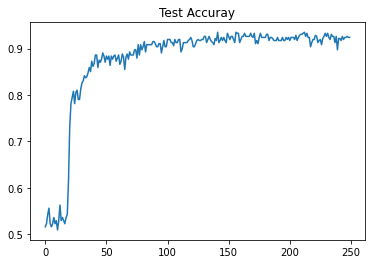

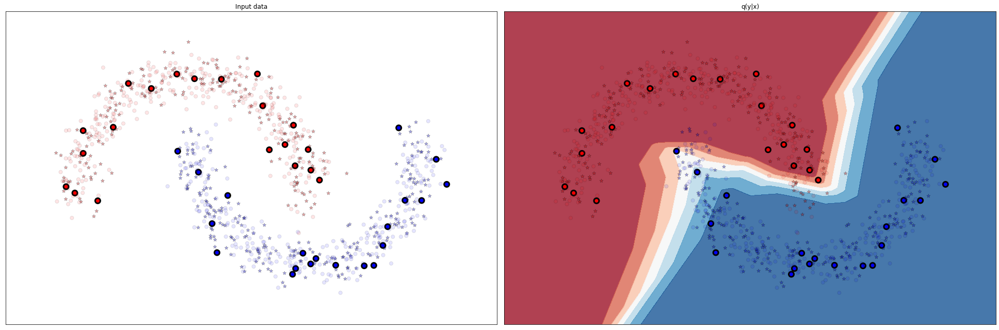

Epoch: 251
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 252
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 253
[Train]		 J_a: 5.71, accuracy: 0.98
[Validation]	 J_a: 5.97, accuracy: 0.92
Epoch: 254
[Train]		 J_a: 5.71, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 255
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 256
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.86, accuracy: 0.93
Epoch: 257
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 258
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 259
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 260
[Train]		 J_a: 5.72, accuracy: 0.99
[Validation]	 J_a: 5.88, accuracy: 0.92


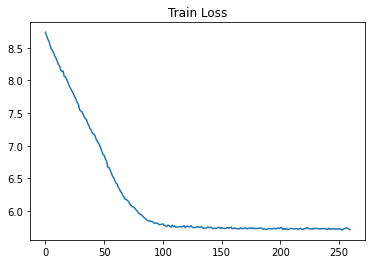

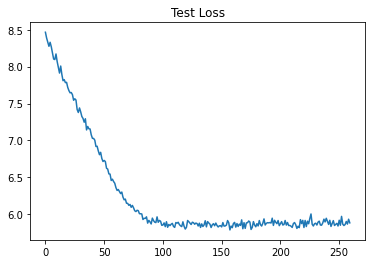

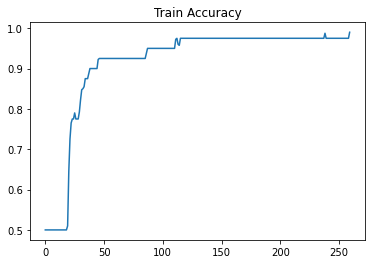

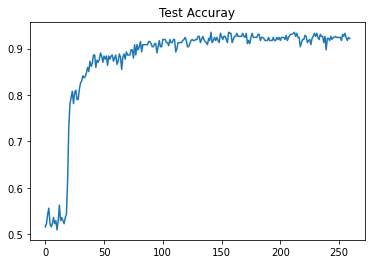

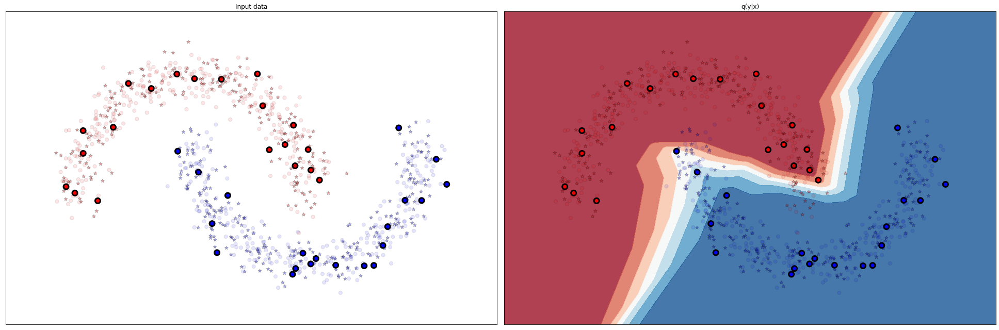

Epoch: 261
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 262
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 263
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 264
[Train]		 J_a: 5.73, accuracy: 0.98
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 265
[Train]		 J_a: 5.72, accuracy: 0.99
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 266
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.93
Epoch: 267
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.93
Epoch: 268
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 269
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 270
[Train]		 J_a: 5.72, accuracy: 0.99
[Validation]	 J_a: 5.85, accuracy: 0.92


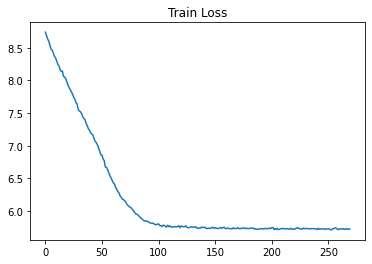

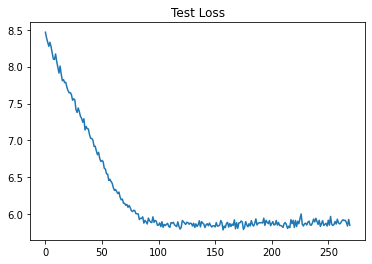

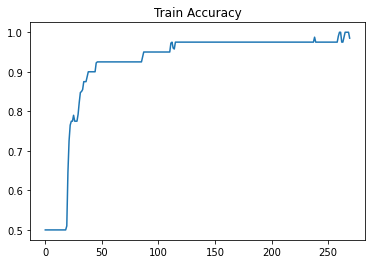

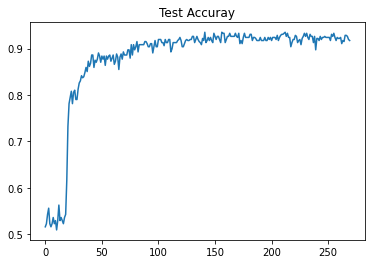

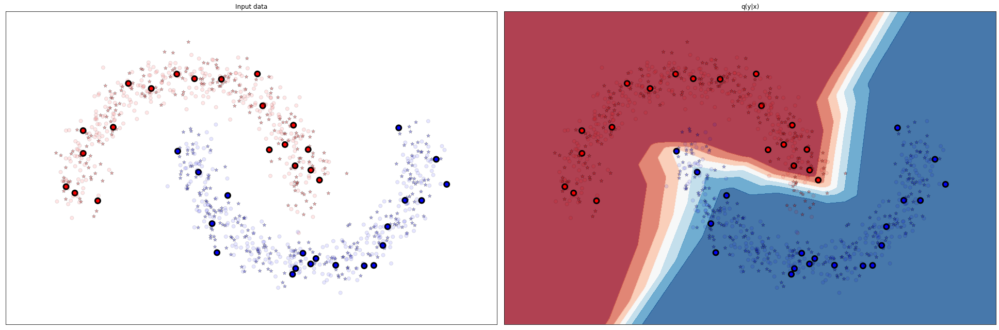

Epoch: 271
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 272
[Train]		 J_a: 5.72, accuracy: 0.98
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 273
[Train]		 J_a: 5.74, accuracy: 0.98
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 274
[Train]		 J_a: 5.73, accuracy: 0.99
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 275
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.83, accuracy: 0.93
Epoch: 276
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 277
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.94
Epoch: 278
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.91
Epoch: 279
[Train]		 J_a: 5.73, accuracy: 0.99
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 280
[Train]		 J_a: 5.72, accuracy: 0.99
[Validation]	 J_a: 5.85, accuracy: 0.93


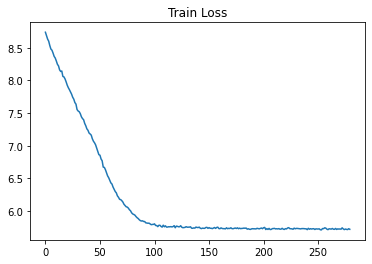

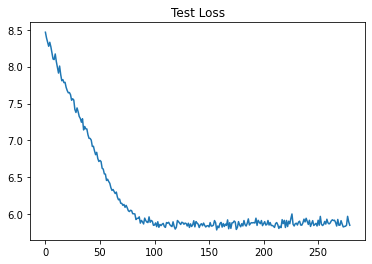

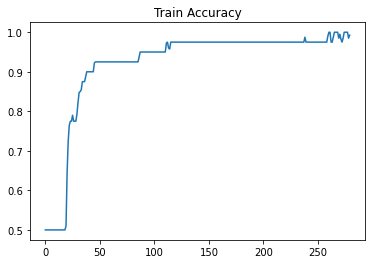

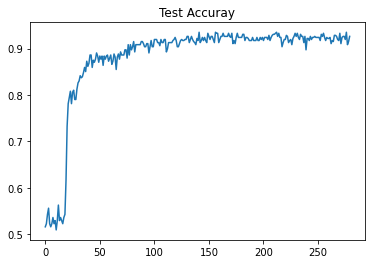

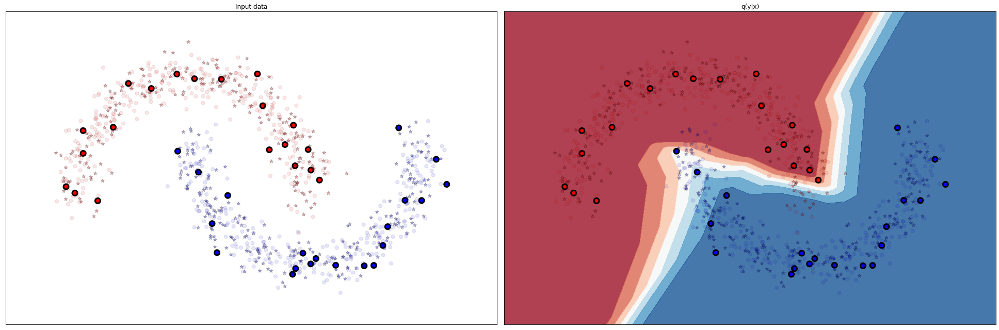

Epoch: 281
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 282
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.93
Epoch: 283
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.94
Epoch: 284
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 285
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.93
Epoch: 286
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 287
[Train]		 J_a: 5.74, accuracy: 0.99
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 288
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.93
Epoch: 289
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.93
Epoch: 290
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.93


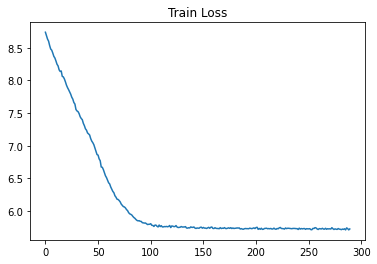

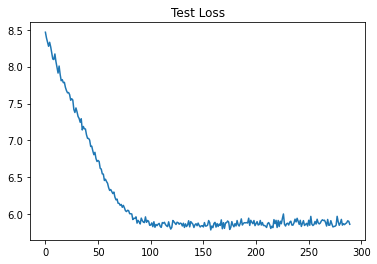

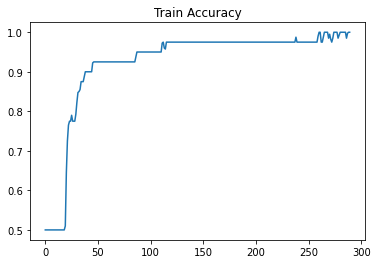

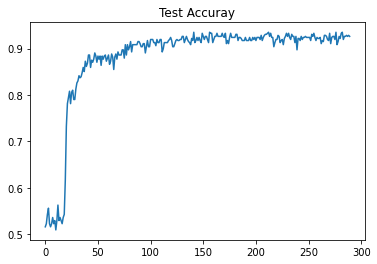

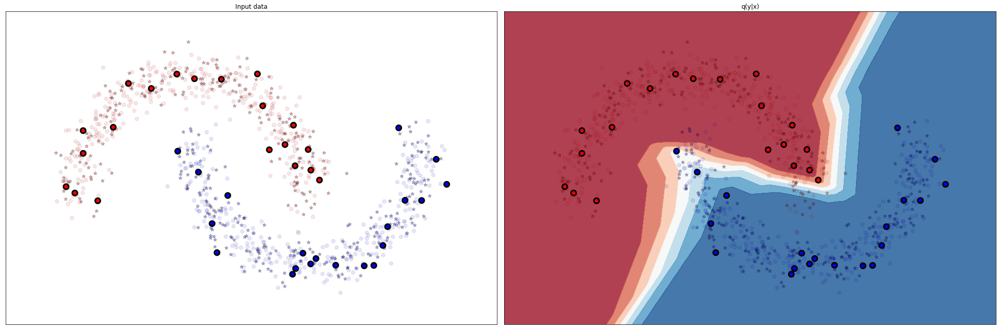

Epoch: 291
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 292
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 293
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 294
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.92
Epoch: 295
[Train]		 J_a: 5.71, accuracy: 0.99
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 296
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 297
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 298
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 299
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 300
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.93


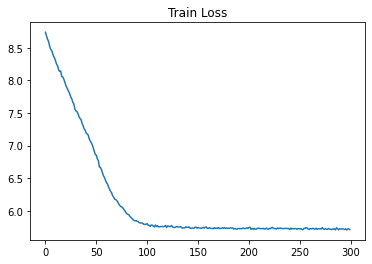

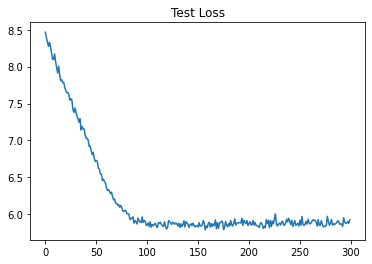

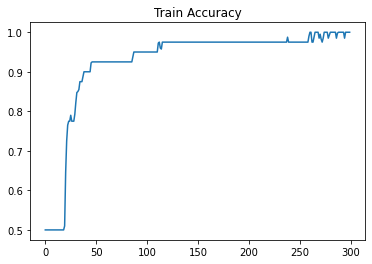

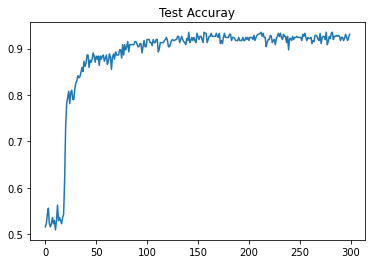

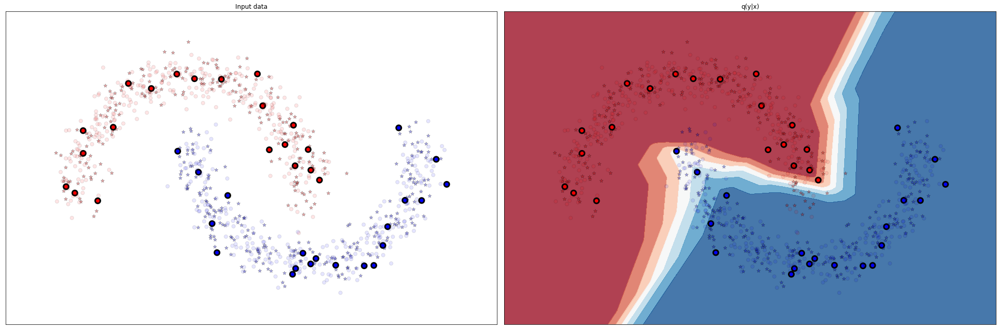

Epoch: 301
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 302
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 303
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.93
Epoch: 304
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 305
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.98, accuracy: 0.91
Epoch: 306
[Train]		 J_a: 5.74, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 307
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 308
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 309
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.93
Epoch: 310
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92


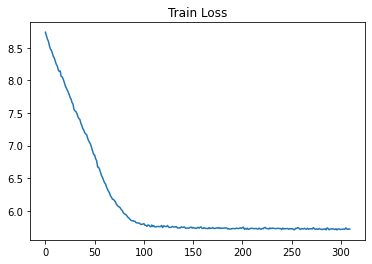

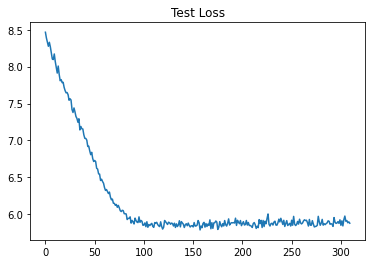

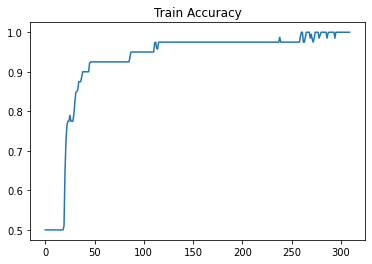

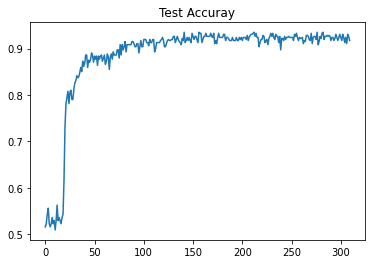

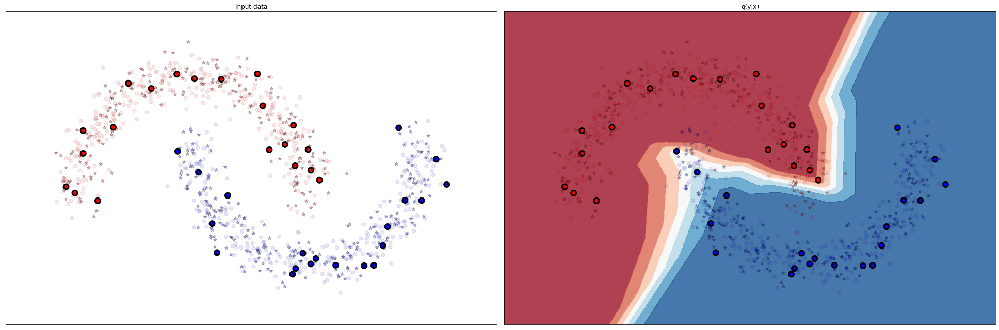

Epoch: 311
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.91
Epoch: 312
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 313
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 314
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 315
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.90
Epoch: 316
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.92
Epoch: 317
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 318
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 319
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 320
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92


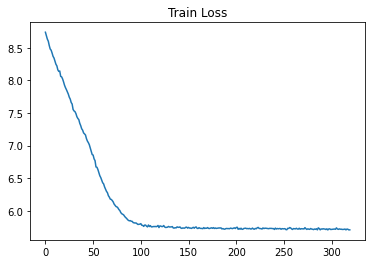

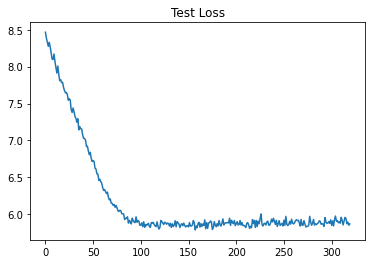

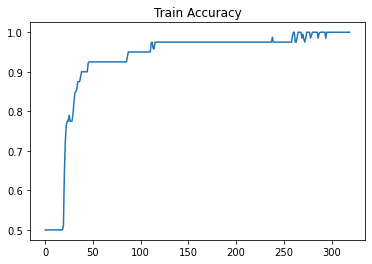

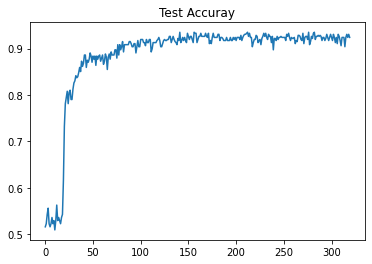

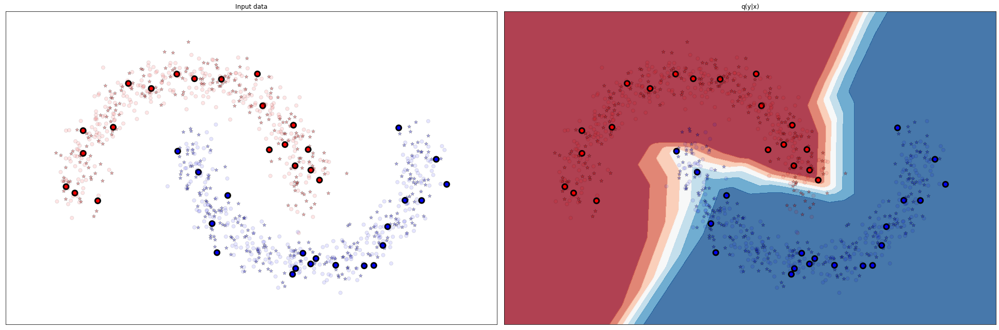

Epoch: 321
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.90
Epoch: 322
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.93
Epoch: 323
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 6.02, accuracy: 0.90
Epoch: 324
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 325
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.93
Epoch: 326
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.91
Epoch: 327
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 328
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.93
Epoch: 329
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.93
Epoch: 330
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92


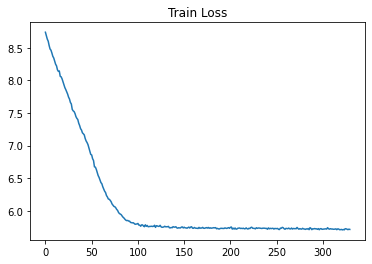

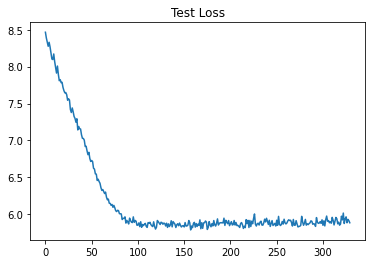

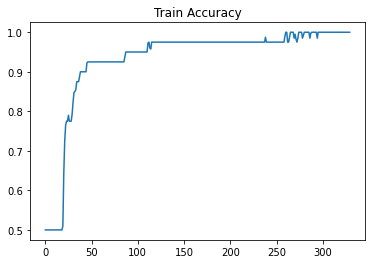

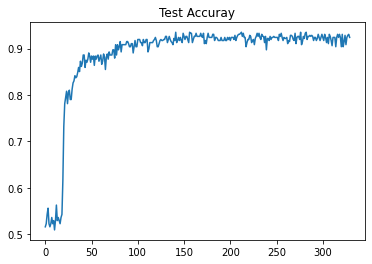

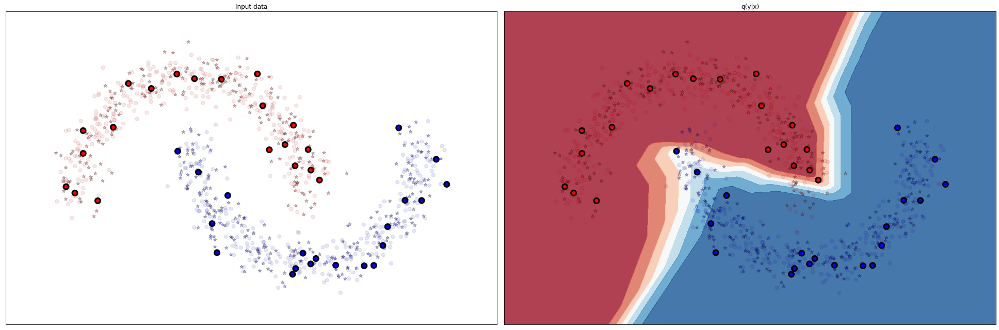

Epoch: 331
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 332
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.93
Epoch: 333
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 334
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 335
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 336
[Train]		 J_a: 5.74, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.93
Epoch: 337
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.93
Epoch: 338
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.92
Epoch: 339
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 340
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.92


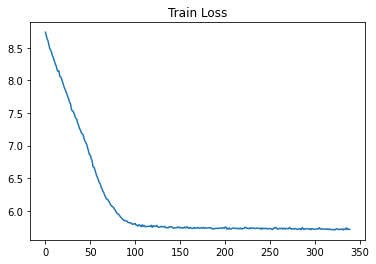

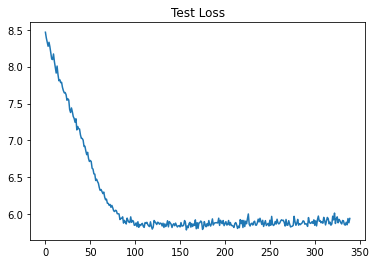

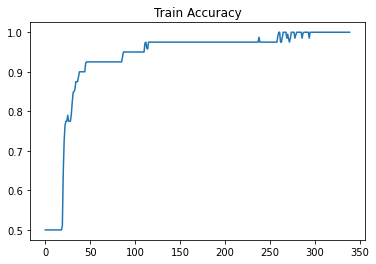

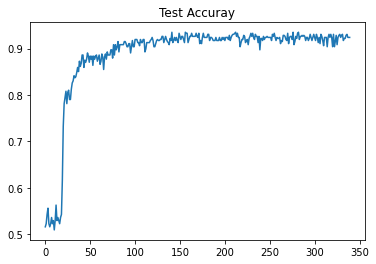

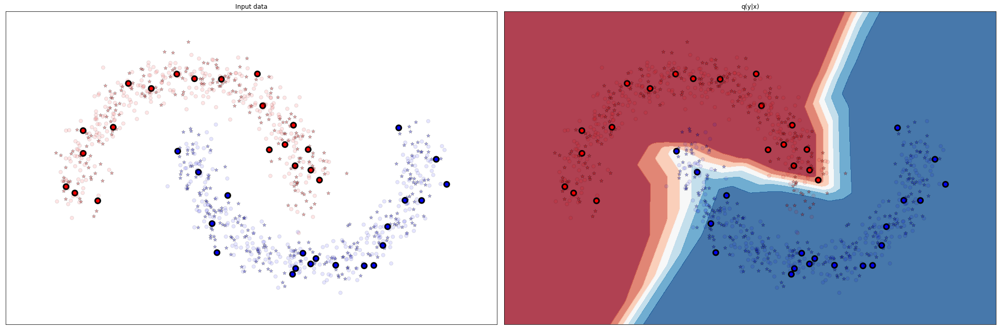

Epoch: 341
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 342
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.93
Epoch: 343
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 344
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.93
Epoch: 345
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 346
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 347
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 6.00, accuracy: 0.90
Epoch: 348
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.92
Epoch: 349
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 350
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92


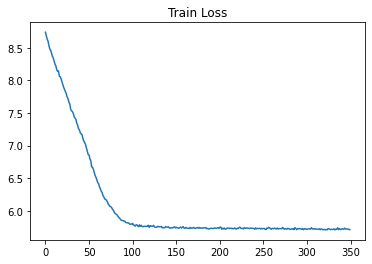

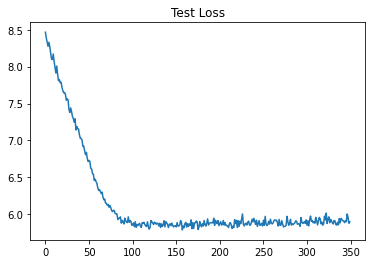

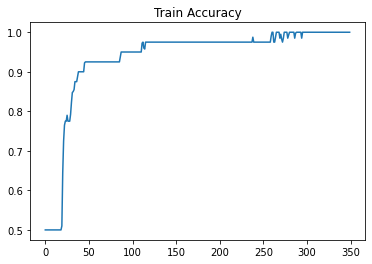

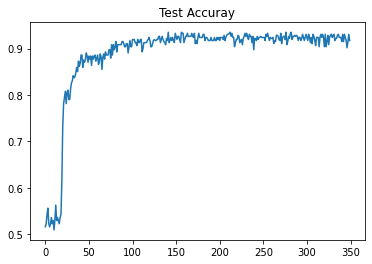

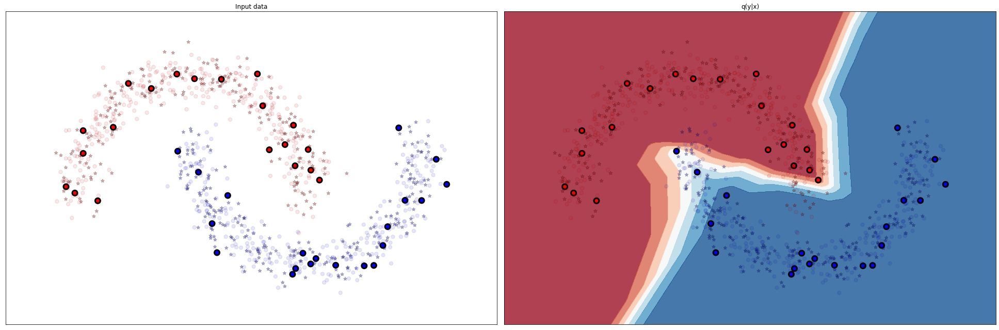

Epoch: 351
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 352
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 353
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 354
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.93
Epoch: 355
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.93
Epoch: 356
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 357
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 358
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.93
Epoch: 359
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 360
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.92


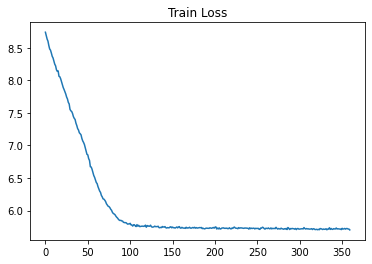

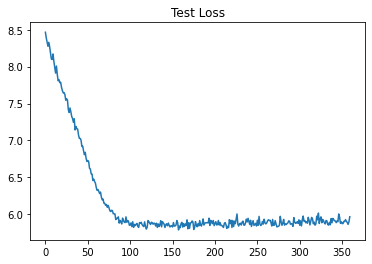

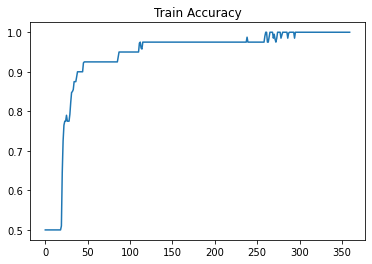

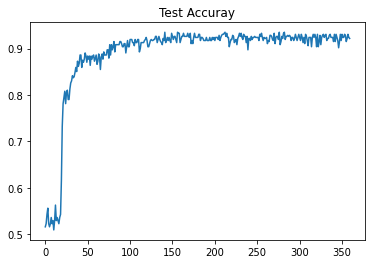

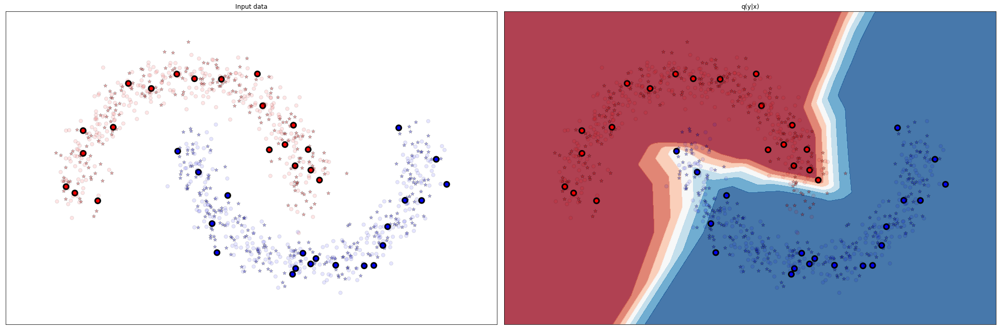

Epoch: 361
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.99, accuracy: 0.90
Epoch: 362
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 363
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.99, accuracy: 0.91
Epoch: 364
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 365
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 366
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.93
Epoch: 367
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 368
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.93
Epoch: 369
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 370
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91


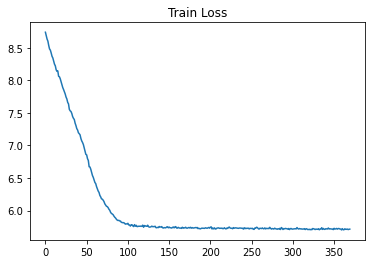

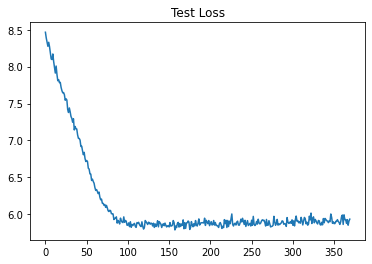

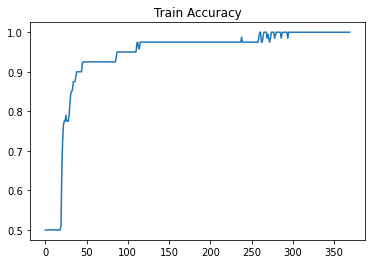

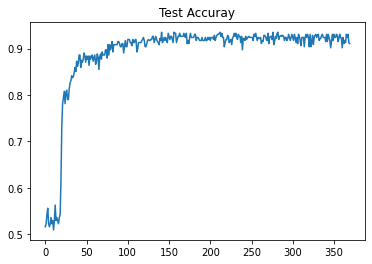

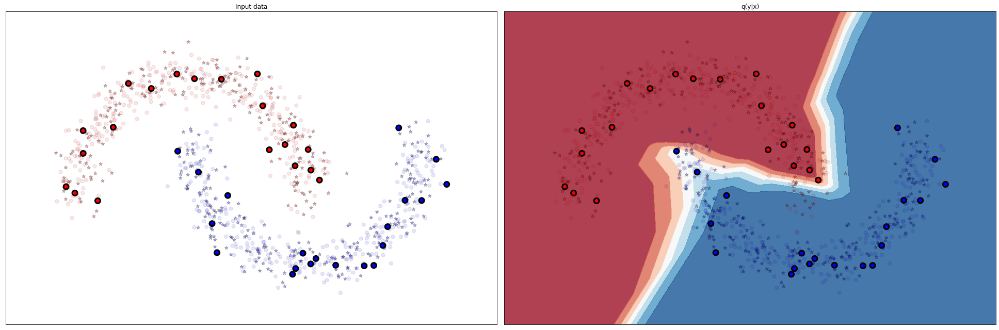

Epoch: 371
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.92
Epoch: 372
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.99, accuracy: 0.91
Epoch: 373
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.92
Epoch: 374
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.93
Epoch: 375
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 376
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.92
Epoch: 377
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 378
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 6.03, accuracy: 0.92
Epoch: 379
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.82, accuracy: 0.93
Epoch: 380
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.92


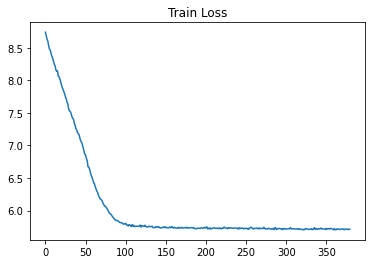

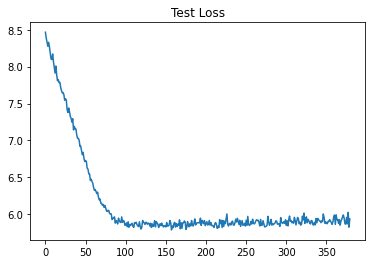

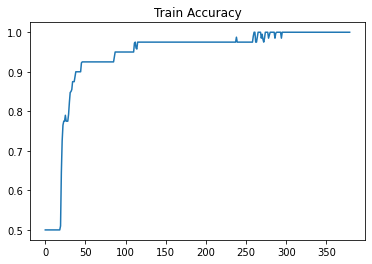

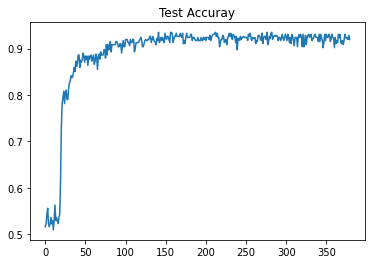

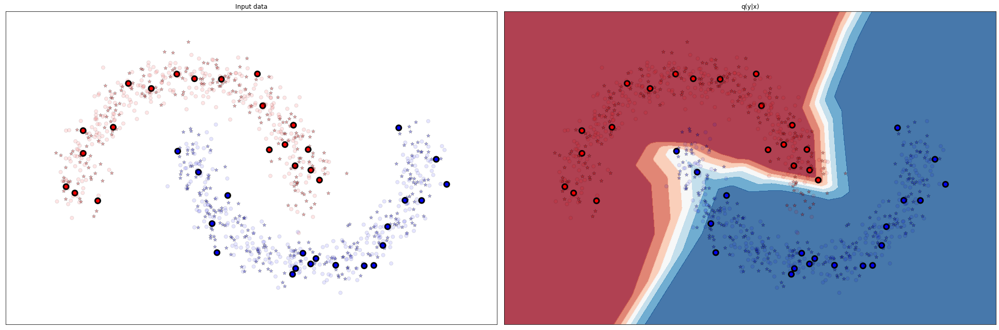

Epoch: 381
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 382
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 383
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92
Epoch: 384
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 385
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.90
Epoch: 386
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 387
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.83, accuracy: 0.92
Epoch: 388
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.93
Epoch: 389
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 390
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 6.00, accuracy: 0.90


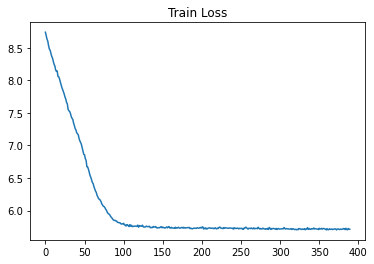

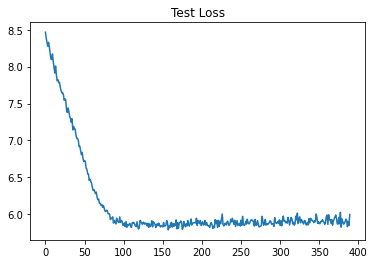

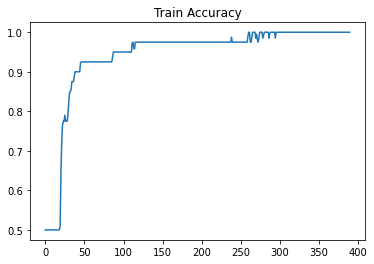

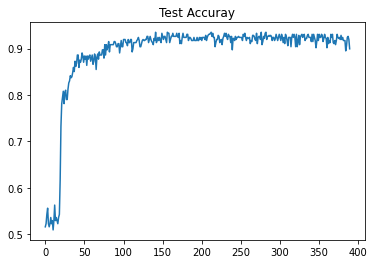

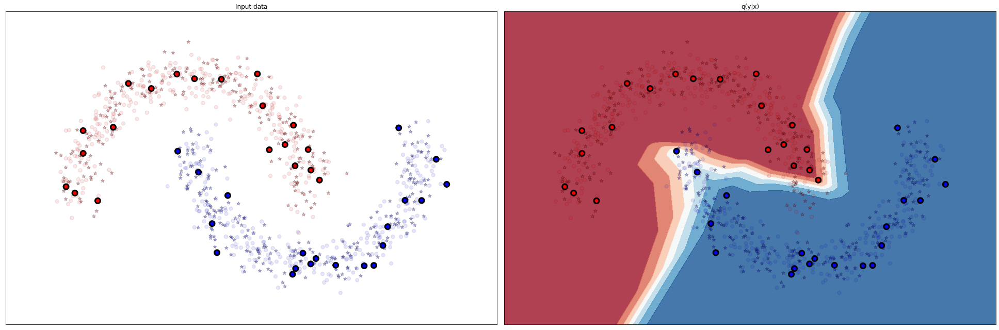

Epoch: 391
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 392
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 393
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 394
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 395
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 396
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 397
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.92
Epoch: 398
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92
Epoch: 399
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.91
Epoch: 400
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.92


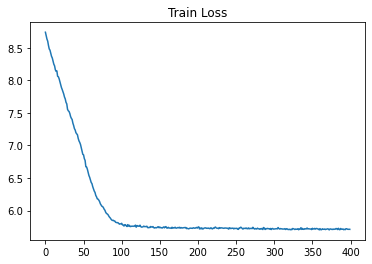

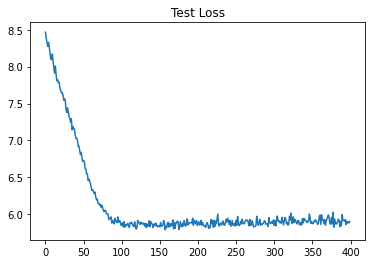

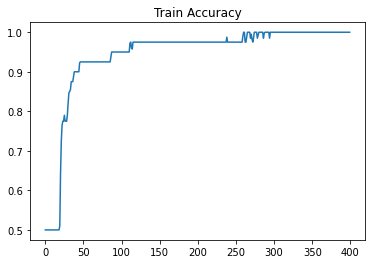

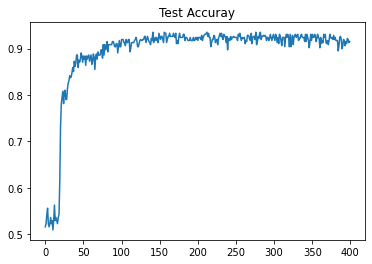

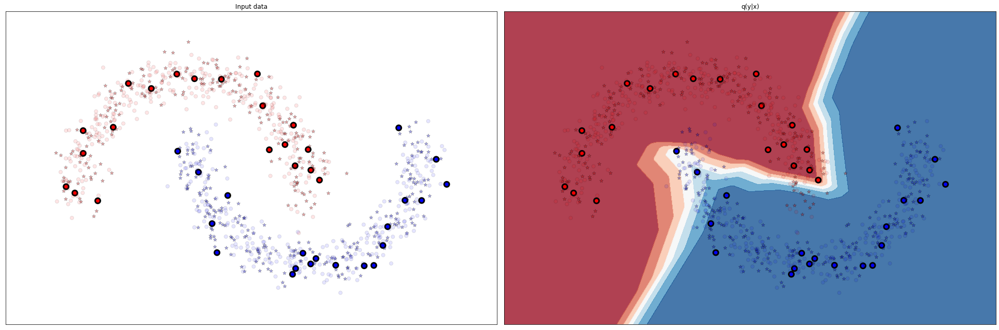

Epoch: 401
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 402
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.93
Epoch: 403
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 404
[Train]		 J_a: 5.74, accuracy: 1.00
[Validation]	 J_a: 5.98, accuracy: 0.89
Epoch: 405
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 406
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 407
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.99, accuracy: 0.90
Epoch: 408
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.92
Epoch: 409
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.98, accuracy: 0.91
Epoch: 410
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.92


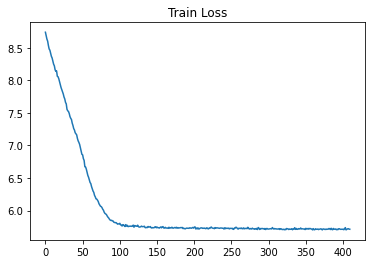

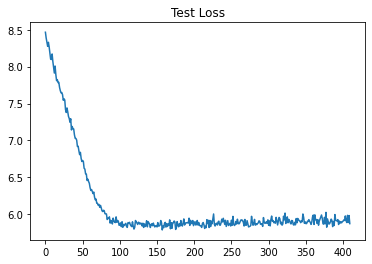

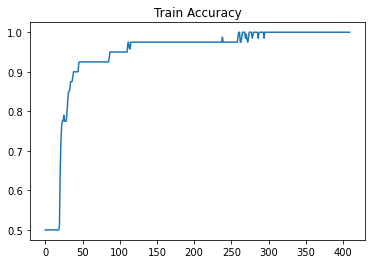

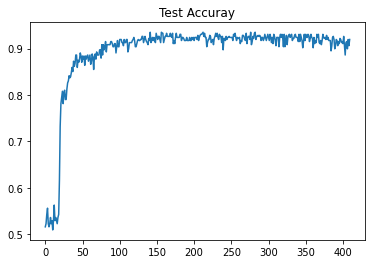

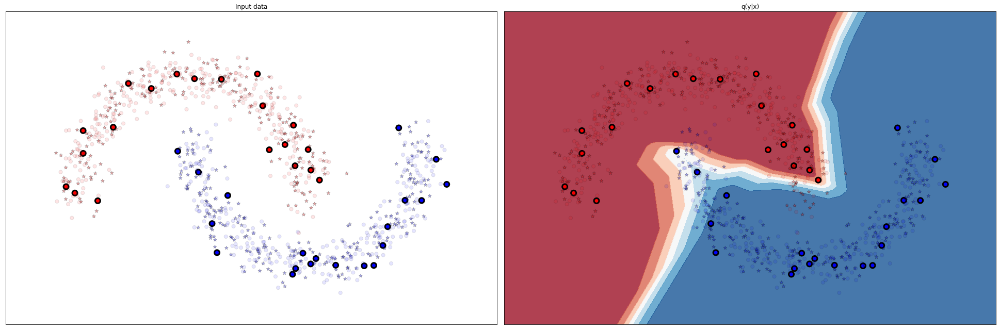

Epoch: 411
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 412
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.98, accuracy: 0.90
Epoch: 413
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 414
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 415
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.92
Epoch: 416
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.91
Epoch: 417
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 418
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 419
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.92
Epoch: 420
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.92


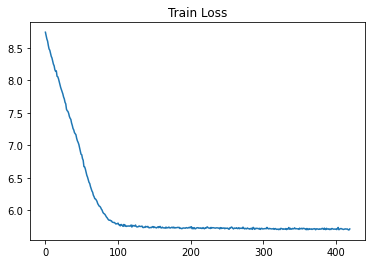

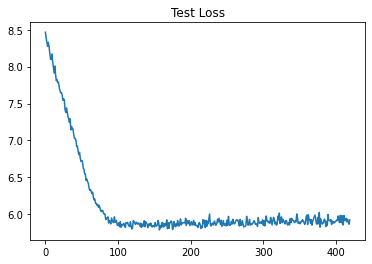

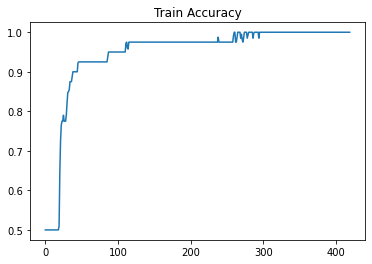

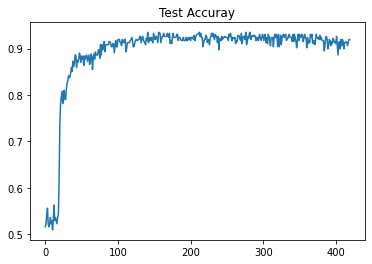

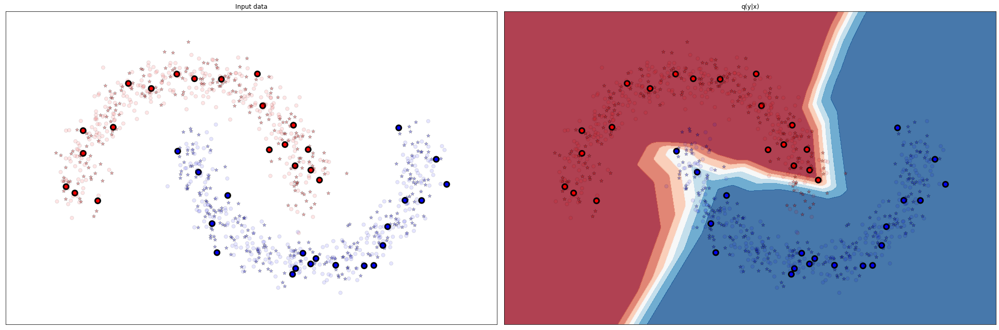

Epoch: 421
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 422
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.91
Epoch: 423
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 424
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 425
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.90
Epoch: 426
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.99, accuracy: 0.90
Epoch: 427
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 428
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 429
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 430
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.91


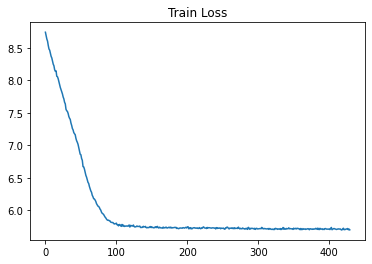

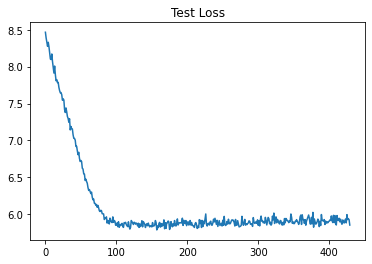

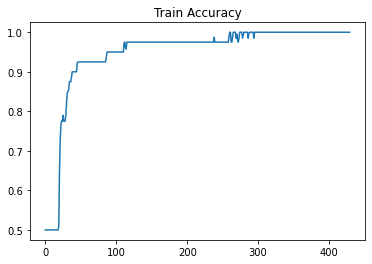

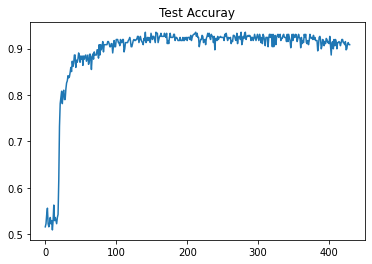

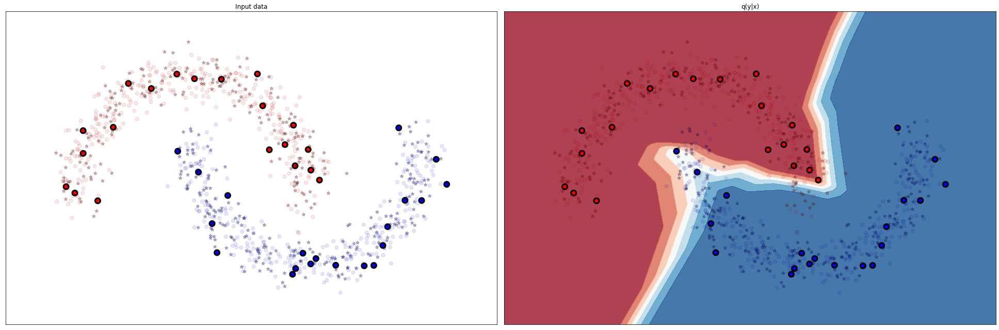

Epoch: 431
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.92
Epoch: 432
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.90
Epoch: 433
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 6.01, accuracy: 0.90
Epoch: 434
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 435
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 436
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 437
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.91
Epoch: 438
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.88
Epoch: 439
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.91
Epoch: 440
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91


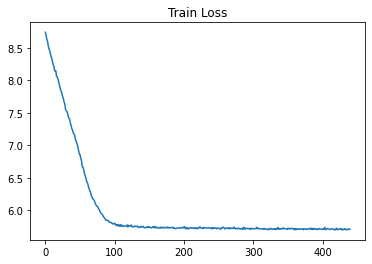

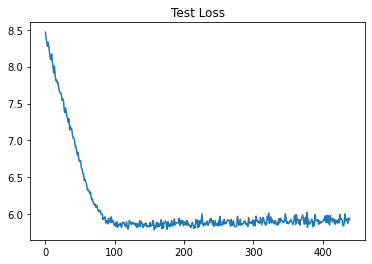

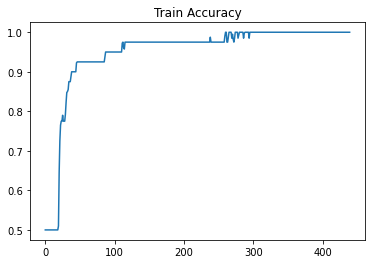

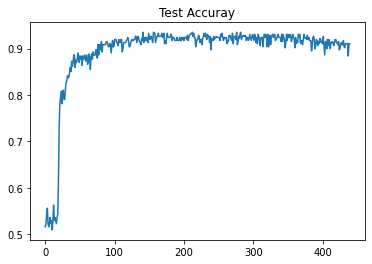

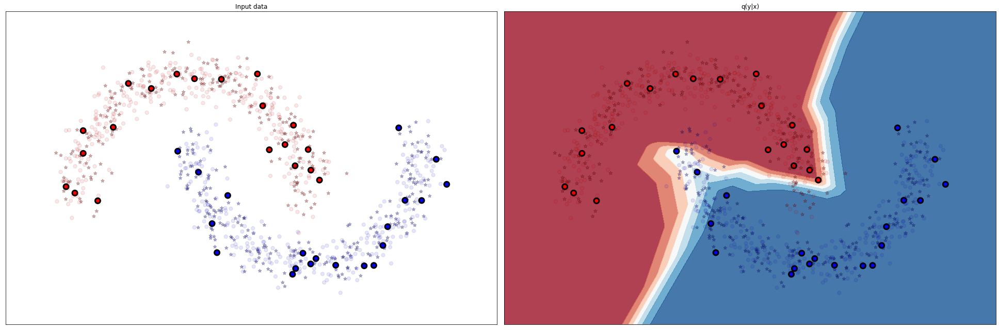

Epoch: 441
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.90
Epoch: 442
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.90
Epoch: 443
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.91
Epoch: 444
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 445
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.90
Epoch: 446
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 447
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.91
Epoch: 448
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 449
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.91
Epoch: 450
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.99, accuracy: 0.90


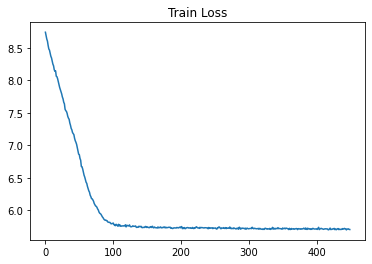

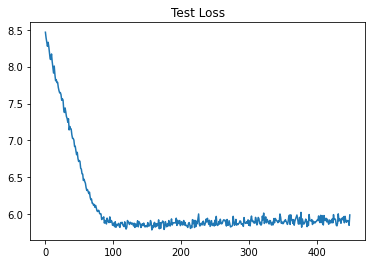

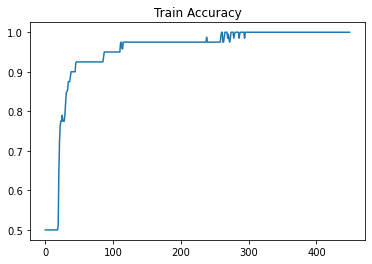

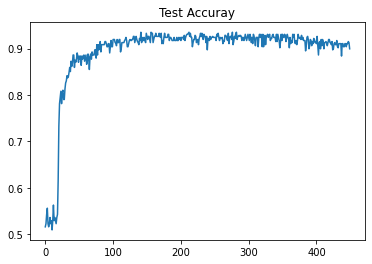

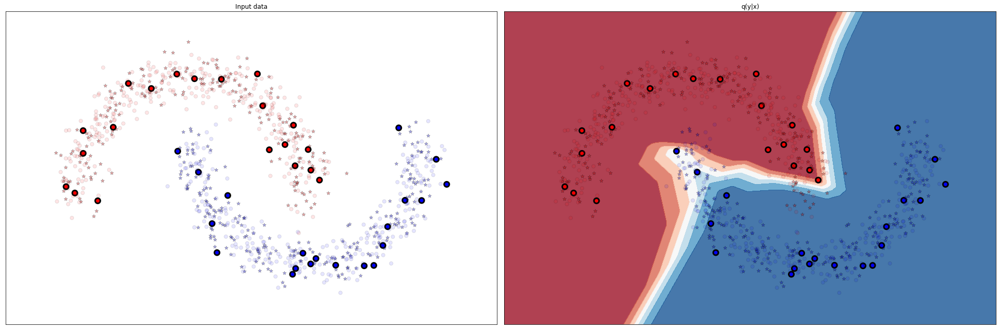

Epoch: 451
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 452
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.90
Epoch: 453
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.90
Epoch: 454
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 455
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 456
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 457
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.90
Epoch: 458
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.90
Epoch: 459
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.92
Epoch: 460
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.88, accuracy: 0.90


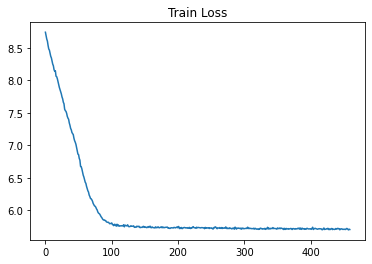

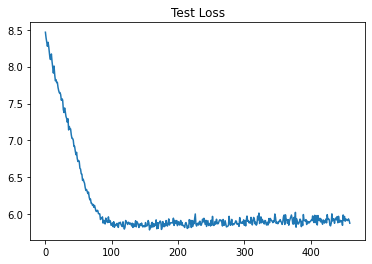

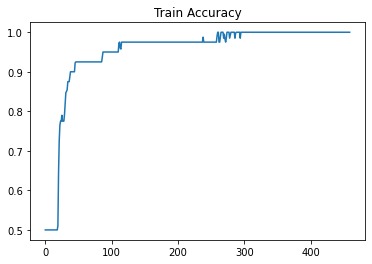

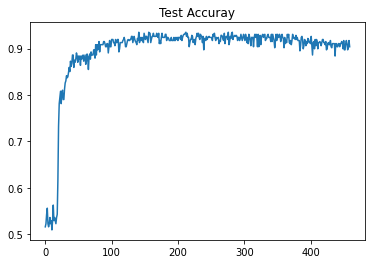

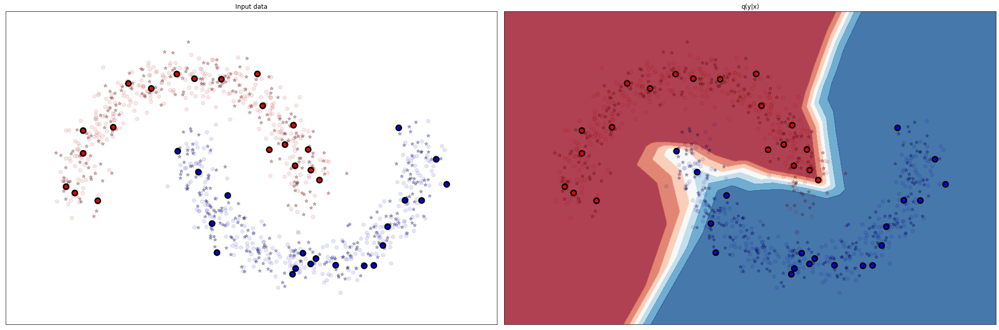

Epoch: 461
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.92
Epoch: 462
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.91
Epoch: 463
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.91
Epoch: 464
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 465
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 466
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 467
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.92
Epoch: 468
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 469
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 470
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.85, accuracy: 0.92


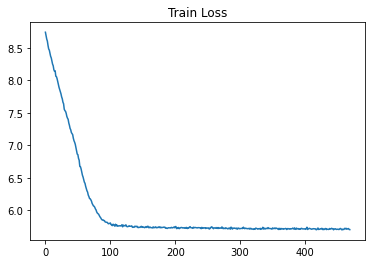

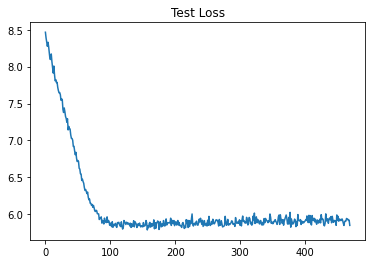

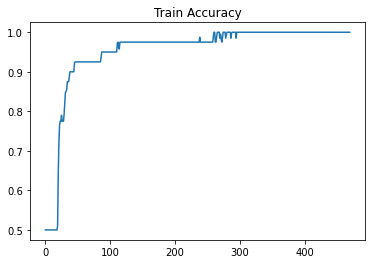

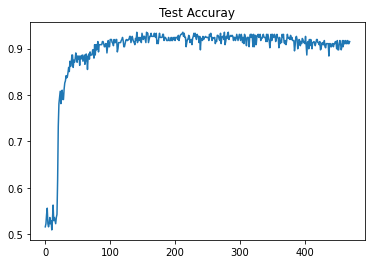

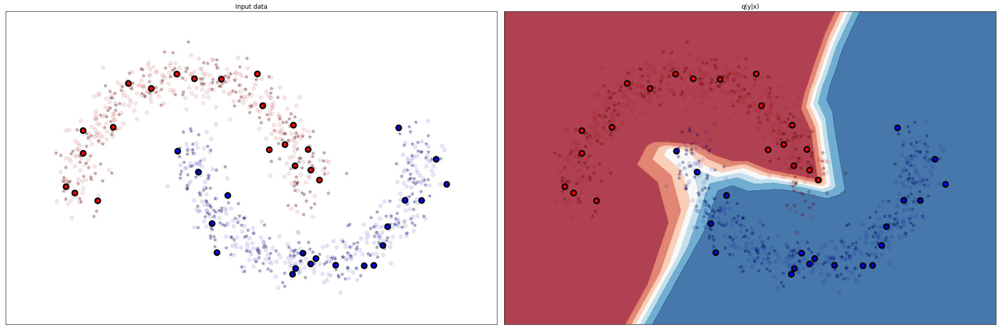

Epoch: 471
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.86, accuracy: 0.91
Epoch: 472
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.90
Epoch: 473
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.90
Epoch: 474
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.90
Epoch: 475
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.90, accuracy: 0.91
Epoch: 476
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.90
Epoch: 477
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.91
Epoch: 478
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.89
Epoch: 479
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 480
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.91


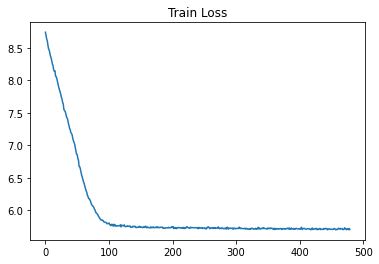

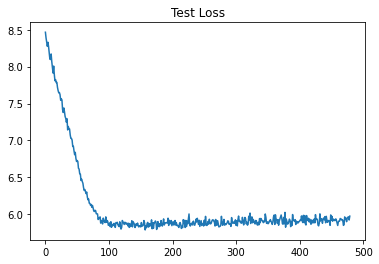

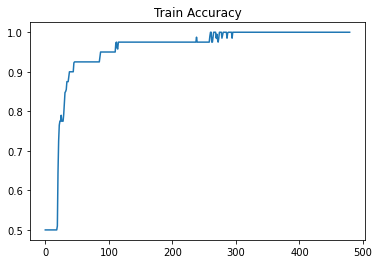

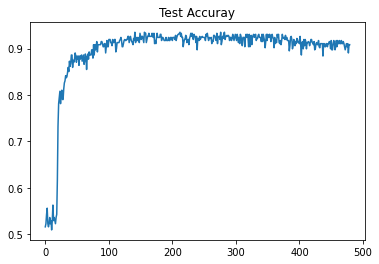

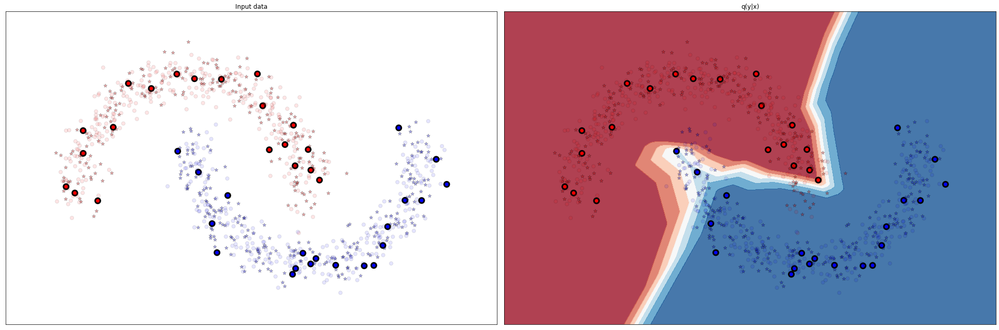

Epoch: 481
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.89
Epoch: 482
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 6.07, accuracy: 0.90
Epoch: 483
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.90
Epoch: 484
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.91
Epoch: 485
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.98, accuracy: 0.90
Epoch: 486
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.95, accuracy: 0.91
Epoch: 487
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 488
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.91
Epoch: 489
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.89
Epoch: 490
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.92, accuracy: 0.90


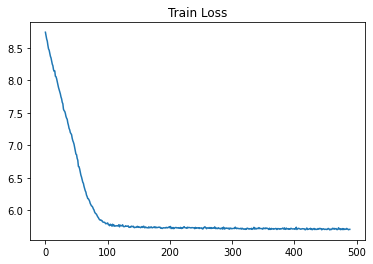

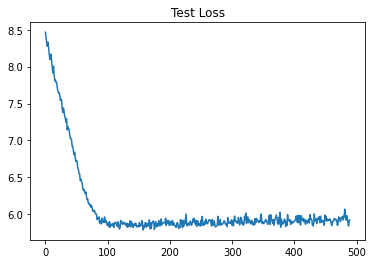

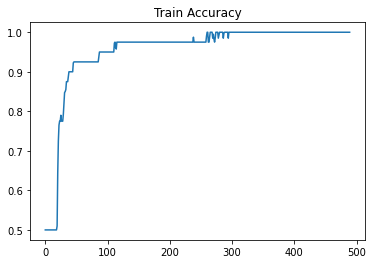

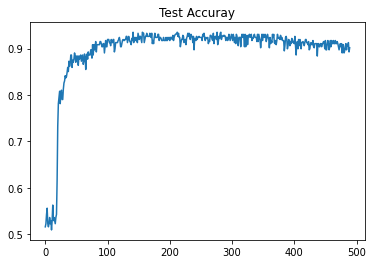

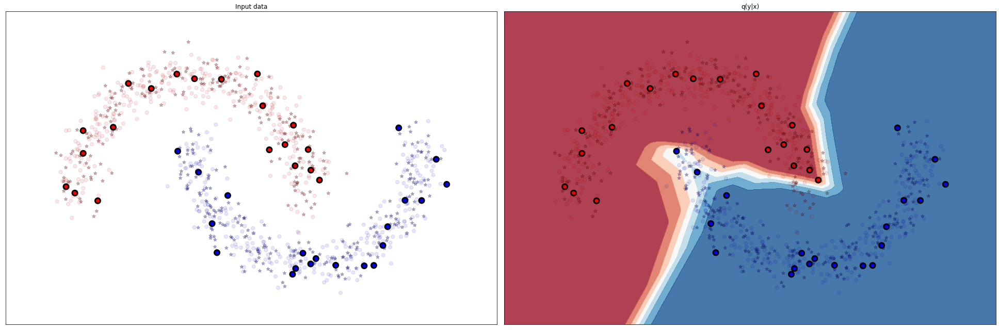

Epoch: 491
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.84, accuracy: 0.91
Epoch: 492
[Train]		 J_a: 5.73, accuracy: 1.00
[Validation]	 J_a: 5.96, accuracy: 0.88
Epoch: 493
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.97, accuracy: 0.91
Epoch: 494
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 495
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91
Epoch: 496
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.87, accuracy: 0.90
Epoch: 497
[Train]		 J_a: 5.72, accuracy: 1.00
[Validation]	 J_a: 5.91, accuracy: 0.92
Epoch: 498
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.89, accuracy: 0.91
Epoch: 499
[Train]		 J_a: 5.70, accuracy: 1.00
[Validation]	 J_a: 5.94, accuracy: 0.91
Epoch: 500
[Train]		 J_a: 5.71, accuracy: 1.00
[Validation]	 J_a: 5.93, accuracy: 0.91


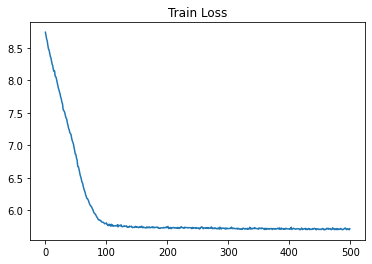

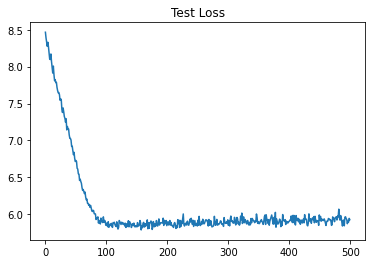

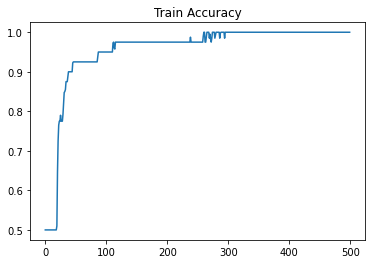

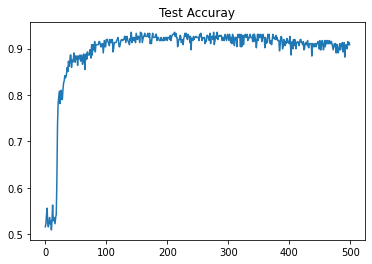

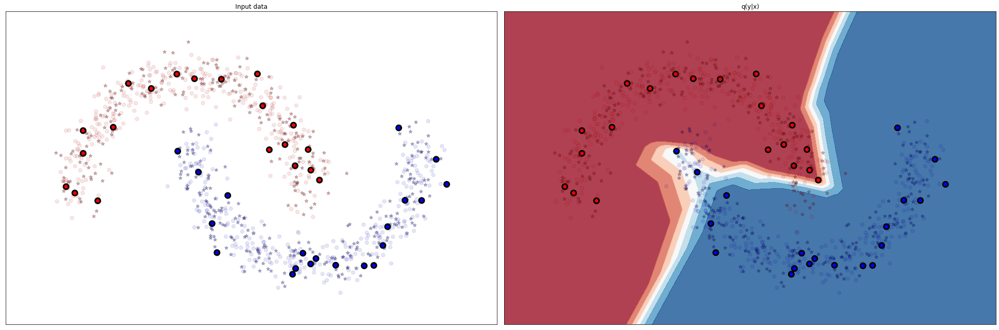

In [11]:
train_loss=[]
test_loss=[]

train_accuracy=[]
test_accuracy=[]

for epoch in range(1, epochs + 1):
    train_l, train_acc = train(epoch)
    test_l, test_acc = test(epoch)

    train_loss.append(train_l)
    test_loss.append(test_l)
    train_accuracy.append(train_acc)
    test_accuracy.append(test_acc)

    if epoch % 10 == 0:
        plt.title('Train Loss')
        plt.plot(train_loss)
        plt.show()

        plt.title('Test Loss')
        plt.plot(test_loss)
        plt.show()

        plt.title('Train Accuracy')
        plt.plot(train_accuracy)
        plt.show()

        plt.title('Test Accuray')
        plt.plot(test_accuracy)
        plt.show()

        sample_x, sample_y = draw_samples()


        # ---------------------------- Plot
        h = .02  # step size in the mesh
        figure = plt.figure(figsize=(27, 9))
        i = 1

        x_min, x_max = min(X_train[:, 0].min(), X_test[:, 0].min()) - .5, max(X_train[:, 0].max(), X_test[:, 0].max()) + .5
        y_min, y_max = min(X_train[:, 1].min(), X_test[:, 1].min()) - .5, max(X_train[:, 1].max(), X_test[:, 1].max()) + .5
        xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                            np.arange(y_min, y_max, h))

        # just plot the dataset first
        cm = plt.cm.RdBu
        cm_bright = ListedColormap(['#FF0000', '#0000FF'])
        ax = plt.subplot(1, 1 + 1, i)
        ax.set_title("Input data")
        # Plot the training points
        ax.scatter(x_lab[:, 0], x_lab[:, 1], c=y_lab, cmap=cm_bright, linewidths=3,
                  edgecolors='k', s=100)
        ax.scatter(u_unlab[:, 0], u_unlab[:, 1], c=v_unlab, cmap=cm_bright,
                  edgecolors='k', alpha=0.1, s=50)
        # Plot the testing points
        ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=cm_bright, alpha=0.3,
                  edgecolors='k', marker="*", s=50)
        ax.set_xlim(xx.min(), xx.max())
        ax.set_ylim(yy.min(), yy.max())
        ax.set_xticks(())
        ax.set_yticks(())
        i += 1

        # # iterate over classifiers
        # for name, clf in zip(names, classifiers):
        ax = plt.subplot(1, 1 + 1, i)

        model.eval()
        boundary = np.c_[xx.ravel(), yy.ravel()]
        boundary = torch.from_numpy(boundary)
        boundary = Variable(boundary.float())
        if use_cuda:
          boundary = boundary.cuda()
        boundary_prob_y = model.classify(boundary)
        boundary_y = boundary_prob_y.data.cpu().numpy()[:,1]

        # Put the result into a color plot
        boundary_y = boundary_y.reshape(xx.shape)
        ax.contourf(xx, yy, boundary_y, cmap=cm, alpha=.8)

        # Plot the training points
        ax.scatter(x_lab[:, 0], x_lab[:, 1], c=y_lab, cmap=cm_bright, linewidths=3,
                  edgecolors='k', s=100)
        ax.scatter(u_unlab[:, 0], u_unlab[:, 1], c=v_unlab, cmap=cm_bright,
                  edgecolors='k', alpha=0.1, s=50)
        # Plot the testing points
        ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=cm_bright, alpha=0.3,
                  edgecolors='k', marker="*", s=50)

        ax.set_xlim(xx.min(), xx.max())
        ax.set_ylim(yy.min(), yy.max())
        ax.set_xticks(())
        ax.set_yticks(())
        # if ds_cnt == 0:
        ax.set_title("q(y|x)")
        # ax.text(xx.max() - .3, yy.min() + .3, ('%.2f' % score).lstrip('0'),
        #         size=15, horizontalalignment='right')
        # i += 1

        plt.tight_layout()
        plt.show()